In [1]:
!pip install -e ..

Obtaining file:///home/kaicohrs/Repositories/dml-4-fluxes/scripts
ERROR: file:///home/kaicohrs/Repositories/dml-4-fluxes/scripts does not appear to be a Python project: neither 'setup.py' nor 'pyproject.toml' found.

[notice] A new release of pip available: 22.2 -> 22.3.1
[notice] To update, run: pip install --upgrade pip


In [1]:
# Imports
%load_ext autoreload
%autoreload 2

import sys
import numpy as np

import matplotlib.pyplot as plt
import scipy.stats as stats

import pandas as pd
from sklearn.metrics import r2_score

from dml4fluxes.experiments import experiment, experiment_utils
from dml4fluxes.analysis.visualization import *
from dml4fluxes.datasets.preprocessing import *
from dml4fluxes.analysis.postprocessing import *

/home/kaicohrs/miniconda3/envs/dml-4-fluxes/lib/python3.8/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [ ]:
dataframe = pd.DataFrame()
data = load_partition(experiment_name, site, year=2015, syn=syn)

data['DateTime'] = data.index
data = unwrap_time(data)
data = standardize_column_names(data)
data = data[list(set(data.columns)
            & set(relevant_variables.variables))]

fig, ax = plt.subplots(6,4, figsize = (10*4,5*6))
for i, (cond, form) in enumerate(zip([['site', 'Year', 'doy'],['site', 'Year'], ['site', 'Year', 'soy'], ['site', 'Year', 'doy']], ['daily', 'yearly', 'seasonal_without_yearly', 'daily_anomalies'])):
    for j, (flux_orth, flux_other) in enumerate(zip([f'GPP_{method}', f'GPP_{method}', 'GPP_NT', f'RECO_{method}', f'RECO_{method}', 'RECO_NT'], ['GPP_NT', 'GPP_DT', 'GPP_DT','RECO_NT', 'RECO_DT', 'RECO_DT'])):
        if QC:
            subdata = data.loc[(data[f'quality_mask_{form}']==1) & (data['QC']==0),:]
        else:
            subdata = data
        x = subdata.groupby(cond).mean()[flux_orth + '_' + form + '_avg']
        y = subdata.groupby(cond).mean()[flux_other + '_' + form + '_avg']
        x, y = without_nans(x,y)
        analysis_plot(x,y, ax[j,i], fluxes = [flux_orth, flux_other], form = form)
fig.tight_layout()

# Fit with full rectangular hyperbola

In [31]:
pre_computed=False
syn=False
relnoise=0
site = 'US-SRG'
dataset_config = dict(
            site_name = site,
            syn = syn,
            version = 'simple',
            Q10=1.5,
            relnoise=relnoise,
            pre_computed=pre_computed,
            transform_T = True,
            month_wise= False,
            moving_window=[3, 5],
            delta = 'heuristic8', #fixed value, max_heuristic, slope_heuristic 
            #X = ['SWC_1', 'doy_sin','doy_cos'], #'CWD'
            X = ['VPD', 'TA', 'SWC_1', 'doy_sin','doy_cos'],
            #X = ['VPD', 'doy_sin','doy_cos', 'TA', 'SWC_1']
            #X = ['VPD', 'doy_sin','doy_cos', 'TA', 'SWC_1', 'SW_ratio'],
            W = [],
            years = 'all', # 'all',
            test_scenario=False,
            RMSE=True,
            alternative_fluxes=None,
            alternative_treatment=None, #"SW_IN_POT",
            good_years_only=True,
            store_parameter=True,
            )
#model_y_config = dict(model = 'GradientBoostingRegressor',
#                    min_samples_split = 5,
#                    min_samples_leaf = 40,
#                    max_depth=1,
#                    n_estimators=300,
#                    #learning_rate=0.1,
#                    #max_depth=3
#                    )

model_y_config = dict(model = 'GradientBoostingRegressor',
                    min_samples_split = 5,
                    min_samples_leaf = 40,
                    max_depth=1,
                    n_estimators=300,
                    n_iter_no_change=5,
                    validation_fraction=0.3,
                    tol=0.01,
                    )

model_t_config = dict(model = 'GradientBoostingRegressor',
                    min_samples_split = 5,
                    min_samples_leaf = 40,
                    max_depth=1,
                    n_estimators=300,
                    n_iter_no_change=5,
                    validation_fraction=0.3,
                    tol=0.01,
                    )
model_final_config = dict(model = 'GradientBoostingRegressor',
                    min_samples_split = 5,
                    min_samples_leaf = 40,
                    max_depth=1,
                    n_estimators=300,
                    n_iter_no_change=10,
                    validation_fraction=0.3,
                    tol=0.00001,
                    
                    )
    
dml_config = dict(cv=10)

model_configs = dict(y = model_y_config,
                    t = model_t_config,
                    final= model_final_config,
                    dml =dml_config)

experiment_config = dict(experiment_type = 'flux_partitioning',
                        comment='Flux partitioning',
                        extrapolate=False,
                        seed=1000)



In [30]:
exp_FR_LBR = experiment.FluxPartDML()
exp_FR_LBR.new(site)
exp_FR_LBR.configs(experiment_config, dataset_config, model_configs)
exp_FR_LBR.prepare_data()
exp_FR_LBR.fit_models()
#exp.all_partitions()
#tables, dictionary = numerical_cross_consistency(exp.experiment_name, syn=False)


Create new experiment folder : /home/kaicohrs/Repositories/dml-4-fluxes/results/FPDML_FR-LBr_2023-04-14_7



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2004
2004 did not pass quality check and is disregarded.
2005



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted wi

2006



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted wi

2007


X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without featur

2008


X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without featur

In [32]:
exp_US_SRG = experiment.FluxPartDML()
exp_US_SRG.new(site)
exp_US_SRG.configs(experiment_config, dataset_config, model_configs)
exp_US_SRG.prepare_data()
exp_US_SRG.fit_models()
#exp.all_partitions()
#tables, dictionary = numerical_cross_consistency(exp.experiment_name, syn=False)


Create new experiment folder : /home/kaicohrs/Repositories/dml-4-fluxes/results/FPDML_US-SRG_2023-04-14_4



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2008
2008 did not pass quality check and is disregarded.
2009


X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without featur

2010


X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without featur

2011


X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without featur

2012


X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without featur

2013


X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without featur

2014


X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without feature names
X has feature names, but GradientBoostingRegressor was fitted without featur

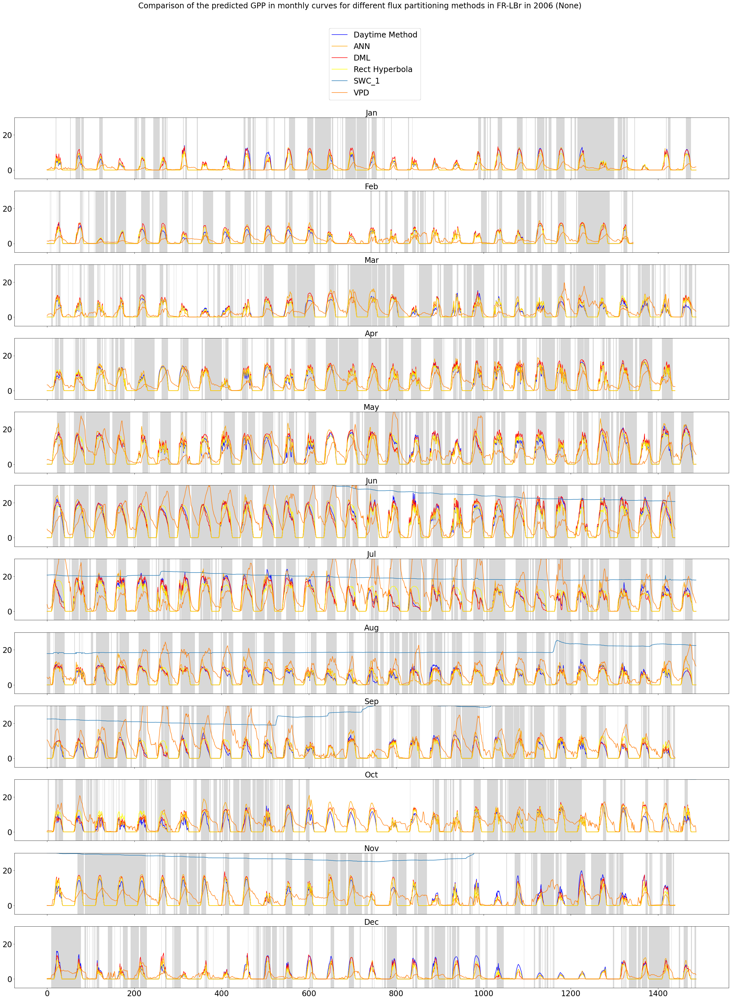

In [49]:
monthly_curves(site='FR-LBr', data=exp_FR_LBR.data, year=2006, flux="GPP", res=False, input=['T','SWC_1', 'VPD'])

In [67]:
exp_FR_LBR.data.loc[(exp_FR_LBR.data['NIGHT'] == 0),:]

,doy,TA,VPD,RH,TS_1,RECO_DT,VPD_QC,RECO_ann,GPP_DT,PA,...,T,GPP_orth,RECO_orth,NEE_orth,T_orth,woy,RECO_orth_res,LUE_orth,alpha,beta
DateTime,,,,,,,,,,,,,,,,,,,,,
2004-12-15 15:45:00,350,11.71,3.069,77.7,8.96,2.28112,0,NaN,3.375500,100.61,...,77.740000,NaN,NaN,NaN,NaN,-99,NaN,NaN,NaN,NaN
2004-12-15 16:15:00,350,11.44,2.866,78.8,9.07,2.23782,0,NaN,2.547170,100.61,...,57.780000,NaN,NaN,NaN,NaN,-99,NaN,NaN,NaN,NaN
2004-12-15 16:45:00,350,10.54,2.089,83.6,9.13,2.09838,0,NaN,1.380670,100.61,...,30.660000,NaN,NaN,NaN,NaN,-99,NaN,NaN,NaN,NaN
2004-12-15 17:15:00,350,9.63,1.594,86.7,9.15,1.96369,0,NaN,0.319888,100.61,...,6.970000,NaN,NaN,NaN,NaN,-99,NaN,NaN,NaN,NaN
2004-12-16 08:45:00,351,5.83,0.638,93.1,8.17,1.48949,0,NaN,0.489890,100.31,...,10.920000,NaN,NaN,NaN,NaN,-99,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2008-12-31 15:15:00,366,10.94,2.328,82.2,8.74,2.15493,0,NaN,6.571480,100.41,...,-7.638703,7.890917,2.484585,-5.406332,-4.382681,-99,1.880717,-1.033018,-0.074267,-27.906309
2008-12-31 15:45:00,366,11.05,2.371,82.0,8.82,2.17391,0,NaN,5.745880,100.41,...,-6.730912,6.953153,2.484585,-4.468568,-4.382681,-99,2.353513,-1.033018,-0.074267,-27.906309
2008-12-31 16:15:00,366,11.29,2.410,82.0,8.90,2.21563,0,NaN,5.143760,100.41,...,-6.059899,6.259985,2.278274,-3.981710,-4.420581,-99,1.367665,-1.033018,-0.074267,-27.906309


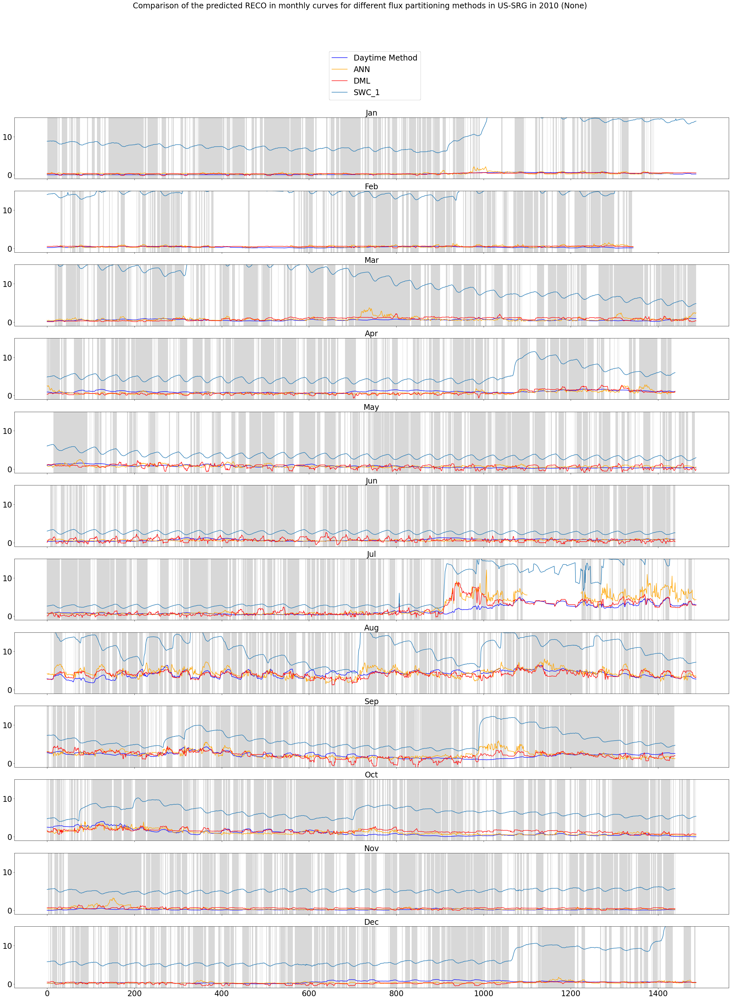

In [51]:
monthly_curves(site='US-SRG', data=exp_US_SRG.data, year=2010, flux="RECO", res=False, input=['SWC_1'])

In [46]:
exp_US_SRG.fitted_models['2012'].est._ortho_learner_model_final._model_final._model.n_estimators_

In [38]:
exp_US_SRG.fitted_models['2010'].est._models_nuisance[0][7]._model_y._model.n_estimators_

In [ ]:
exp_FR_LBR.fitted_models.keys()

Text(0.5, 0.98, 'Functional relationship of lue factor on VPD and TA at FR-LBr')

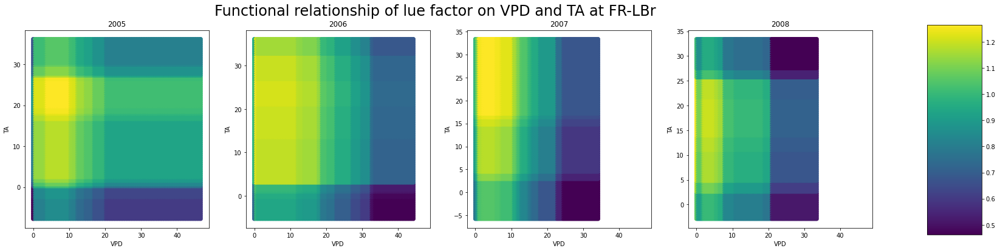

In [47]:
X = ['VPD', 'TA', 'SWC_1', 'doy_sin','doy_cos']
fig, axes = plt.subplots(1,4, figsize=(25,6), sharex=True)

for i, ax in enumerate(axes.flatten()):
    year = 2005+i
    if str(year) in exp_FR_LBR.fitted_models.keys():
        var1 = 'VPD'
        var2 = 'TA'
        subdata = exp_FR_LBR.data[exp_FR_LBR.data['Year']==year]

        X = np.zeros([10000,5])
        #value1 = np.dstack(np.meshgrid(np.linspace(exp_FR_LBR.X.min()[0], exp_FR_LBR.X.max()[0], 100), np.linspace(exp_FR_LBR.X.min()[0], exp_FR_LBR.X.max()[0], 100))).reshape(-1, 2)[:,0]
        #value2 = np.dstack(np.meshgrid(np.linspace(exp_FR_LBR.X.min()[1], exp_FR_LBR.X.max()[1], 100), np.linspace(exp_FR_LBR.X.min()[1], exp_FR_LBR.X.max()[1], 100))).reshape(-1, 2)[:,1]
        value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
        value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
        X[:,0] = value1
        X[:,1] = value2
        X[:,2] = subdata.SWC_1.mean()
        #X[:,3] = subdata.CWD.mean()
        (X[:,3], _), (X[:,4], _) = make_cyclic(np.array((150,365)))
        #make_cyclic(250)

        #X[:,1], X[:,2] = make_cyclic(value2)
        ax.set_xlabel("VPD")
        ax.set_ylabel("TA")
        new = -exp_FR_LBR.fitted_models[str(year)].lue(X)
        #new[new > 0]=0
        
        ax.set_title(year, fontsize=12)
        im = ax.scatter(value1, value2, c=new)
        #fig.colorbar(cmap='viridis', ax=ax)
        #cbar = fig.colorbar(cm.ScalarMappable(cmap='viridis'), ax=ax)
        #plt.colorbar(label="Lue_orth", orientation="horizontal", ax=ax)
bottom, top = 0.1, 0.9
left, right = 0.1, 0.8
cbar_ax = fig.add_axes([0.95, bottom, 0.05, top-bottom])        
fig.colorbar(im, cax=cbar_ax)
fig.suptitle(f'Functional relationship of lue factor on {var1} and {var2} at {exp_FR_LBR.site}', fontsize=24)

Text(0.5, 0.98, 'Functional relationship of lue factor on VPD and SWC_1 at US-SRG')

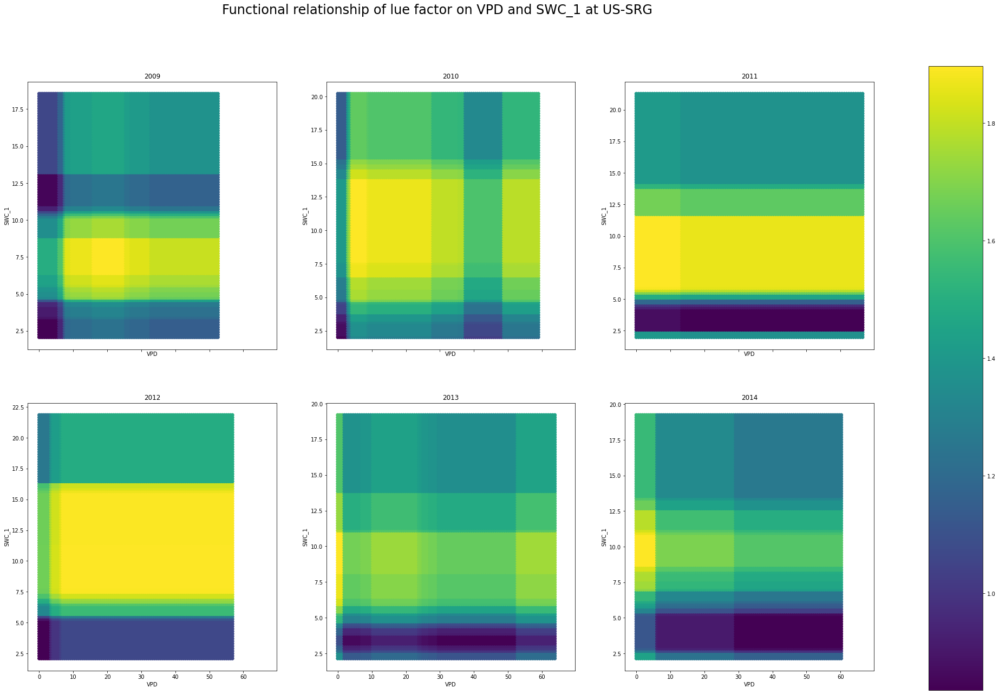

In [34]:
X = ['VPD', 'TA', 'SWC_1', 'doy_sin','doy_cos']
fig, axes = plt.subplots(2,3, figsize=(28,20), sharex=True)

for i, ax in enumerate(axes.flatten()):
    year = 2009+i
    if str(year) in exp_US_SRG.fitted_models.keys():
        var1 = 'VPD'
        var2 = 'SWC_1'
        subdata = exp_US_SRG.data[exp_US_SRG.data['Year']==year]

        X = np.zeros([10000,5])
        #value1 = np.dstack(np.meshgrid(np.linspace(exp_US_SRG.X.min()[0], exp_US_SRG.X.max()[0], 100), np.linspace(exp_US_SRG.X.min()[0], exp_US_SRG.X.max()[0], 100))).reshape(-1, 2)[:,0]
        #value2 = np.dstack(np.meshgrid(np.linspace(exp_US_SRG.X.min()[1], exp_US_SRG.X.max()[1], 100), np.linspace(exp_US_SRG.X.min()[1], exp_US_SRG.X.max()[1], 100))).reshape(-1, 2)[:,1]
        value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
        value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
        X[:,0] = value1
        X[:,1] = subdata.TA.mean()
        X[:,2] = value2
        #X[:,3] = subdata.CWD.mean()
        (X[:,3], _), (X[:,4], _) = make_cyclic(np.array((150,365)))
        #make_cyclic(250)

        #X[:,1], X[:,2] = make_cyclic(value2)
        ax.set_xlabel("VPD")
        ax.set_ylabel("SWC_1")
        new = -exp_US_SRG.fitted_models[str(year)].lue(X)
        #new[new > 0]=0
        
        ax.set_title(year, fontsize=12)
        im = ax.scatter(value1, value2, c=new)
        #fig.colorbar(cmap='viridis', ax=ax)
        #cbar = fig.colorbar(cm.ScalarMappable(cmap='viridis'), ax=ax)
        #plt.colorbar(label="Lue_orth", orientation="horizontal", ax=ax)
bottom, top = 0.1, 0.9
left, right = 0.1, 0.8
cbar_ax = fig.add_axes([0.95, bottom, 0.05, top-bottom])        
fig.colorbar(im, cax=cbar_ax)
fig.suptitle(f'Functional relationship of lue factor on {var1} and {var2} at {exp_US_SRG.site}', fontsize=24)

Text(0.5, 0.98, 'Functional relationship of lue factor on doy and SWC_1 at US-SRG')

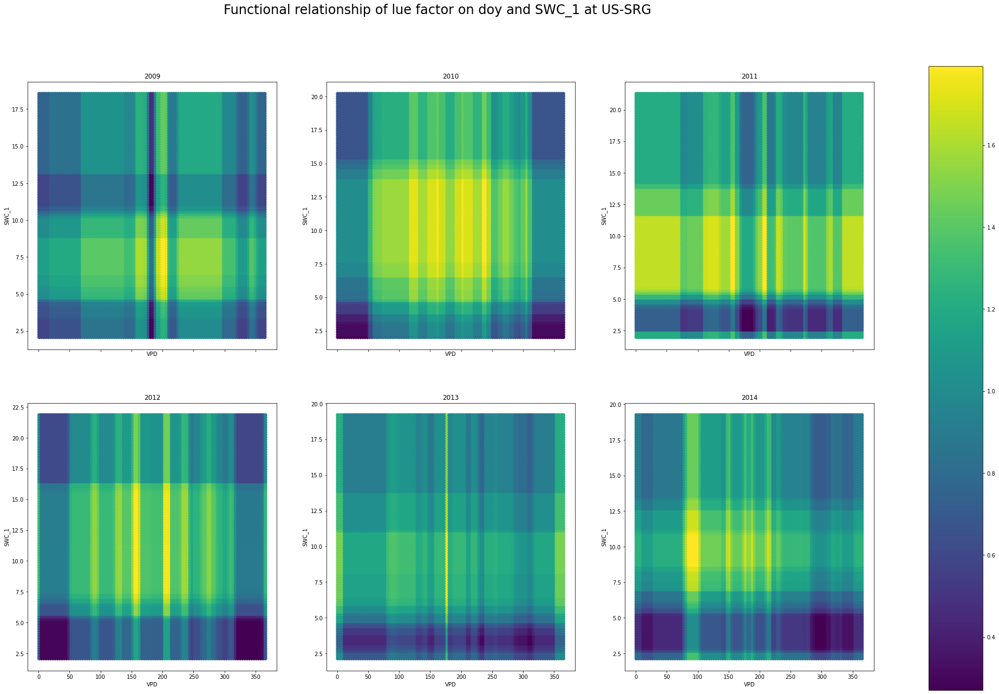

In [35]:
X = ['VPD', 'TA', 'SWC_1', 'doy_sin','doy_cos']
fig, axes = plt.subplots(2,3, figsize=(28,20), sharex=True)

for i, ax in enumerate(axes.flatten()):
    year = 2009+i
    if str(year) in exp_US_SRG.fitted_models.keys():
        var1 = 'doy'
        var2 = 'SWC_1'
        subdata = exp_US_SRG.data[exp_US_SRG.data['Year']==year]

        X = np.zeros([10000,5])
        #value1 = np.dstack(np.meshgrid(np.linspace(exp_US_SRG.X.min()[0], exp_US_SRG.X.max()[0], 100), np.linspace(exp_US_SRG.X.min()[0], exp_US_SRG.X.max()[0], 100))).reshape(-1, 2)[:,0]
        #value2 = np.dstack(np.meshgrid(np.linspace(exp_US_SRG.X.min()[1], exp_US_SRG.X.max()[1], 100), np.linspace(exp_US_SRG.X.min()[1], exp_US_SRG.X.max()[1], 100))).reshape(-1, 2)[:,1]
        value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
        value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
        X[:,0] = subdata.VPD.mean()
        X[:,1] = subdata.TA.mean()
        X[:,2] = value2
        #X[:,3] = subdata.CWD.mean()
        #(X[:,3], _), (X[:,4], _) = make_cyclic(np.array((150,365)))
        #make_cyclic(250)

        X[:,3], X[:,4] = make_cyclic(value1)
        ax.set_xlabel("VPD")
        ax.set_ylabel("SWC_1")
        new = -exp_US_SRG.fitted_models[str(year)].lue(X)
        #new[new > 0]=0
        
        ax.set_title(year, fontsize=12)
        im = ax.scatter(value1, value2, c=new)
        #fig.colorbar(cmap='viridis', ax=ax)
        #cbar = fig.colorbar(cm.ScalarMappable(cmap='viridis'), ax=ax)
        #plt.colorbar(label="Lue_orth", orientation="horizontal", ax=ax)
bottom, top = 0.1, 0.9
left, right = 0.1, 0.8
cbar_ax = fig.add_axes([0.95, bottom, 0.05, top-bottom])        
fig.colorbar(im, cax=cbar_ax)
fig.suptitle(f'Functional relationship of lue factor on {var1} and {var2} at {exp_US_SRG.site}', fontsize=24)

Text(0.5, 0.98, 'Functional relationship of lue factor on doy and SWC_1 at US-SRG')

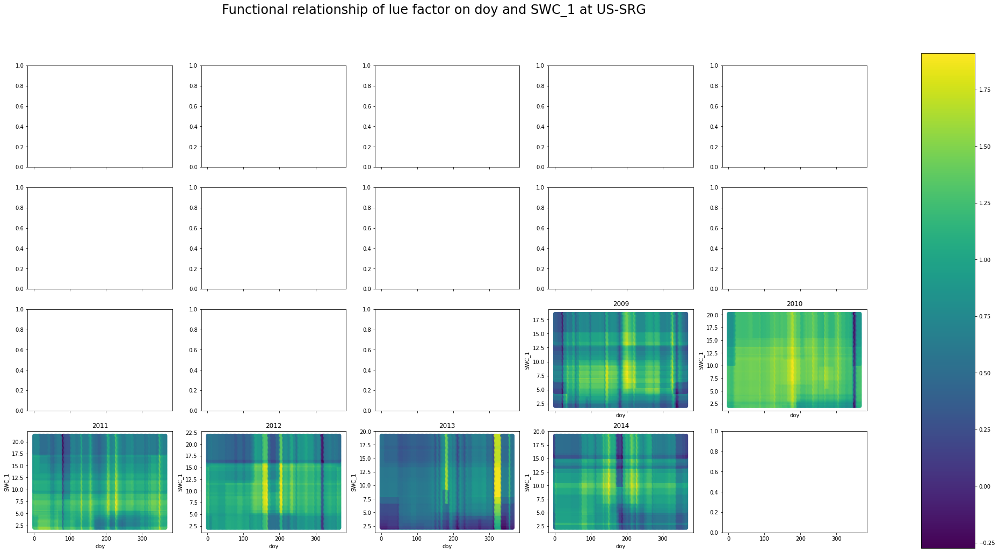

In [65]:
X = ['VPD','TA','SW_ratio', 'SWC_1','doy_sin','doy_cos'],
fig, axes = plt.subplots(4,5, figsize=(28,16), sharex=True)

for i, ax in enumerate(axes.flatten()):
    year = 1996+i
    if str(year) in exp.fitted_models.keys():
        var1 = 'doy'
        var2 = 'SWC_1'
        subdata = exp.data[exp.data['Year']==year]

        X = np.zeros([10000,3])
        #value1 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[0], exp.X.max()[0], 100), np.linspace(exp.X.min()[0], exp.X.max()[0], 100))).reshape(-1, 2)[:,0]
        #value2 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[1], exp.X.max()[1], 100), np.linspace(exp.X.min()[1], exp.X.max()[1], 100))).reshape(-1, 2)[:,1]
        value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
        value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
        #X[:,0] = subdata.VPD.mean()
        X[:,0] = value2
        #X[:,2] = subdata.SW_ratio.mean()
        #X[:,3] = subdata.CWD.mean()
        X[:,1], X[:,2] = make_cyclic(value1)
        #make_cyclic(250)

        #X[:,1], X[:,2] = make_cyclic(value2)
        ax.set_xlabel("doy")
        ax.set_ylabel("SWC_1")
        new = -exp.fitted_models[str(year)].lue(X)
        #new[new > 0]=0
        
        ax.set_title(year, fontsize=12)
        im = ax.scatter(value1, value2, c=new)
        #fig.colorbar(cmap='viridis', ax=ax)
        #cbar = fig.colorbar(cm.ScalarMappable(cmap='viridis'), ax=ax)
        #plt.colorbar(label="Lue_orth", orientation="horizontal", ax=ax)
bottom, top = 0.1, 0.9
left, right = 0.1, 0.8
cbar_ax = fig.add_axes([0.95, bottom, 0.05, top-bottom])        
fig.colorbar(im, cax=cbar_ax)
fig.suptitle(f'Functional relationship of lue factor on {var1} and {var2} at {exp.site}', fontsize=24)

# Run partitioning from FluxPart Class

In [164]:
pre_computed=False
syn=False
relnoise=0
site = 'NL-Loo'
dataset_config = dict(
            site_name = site,
            syn = syn,
            version = 'simple',
            Q10=1.5,
            relnoise=relnoise,
            pre_computed=pre_computed,
            transform_T = True,
            month_wise= False,
            moving_window=[3, 5],
            delta = 'heuristic8', #fixed value, max_heuristic, slope_heuristic 
            #X = ['SWC_1', 'doy_sin','doy_cos'], #'CWD'
            X = ['VPD', 'SW_ratio', 'TA'],
            #X = ['VPD', 'TA','wdefcum', , 'PA', 'WS', 'GPP_prox', 'P', 'WD_sin', 'WD_cos', 'NEE_nt_avg', 'TS_1', 'TS_2', 'SWC_1', 'SWC_2', 'SW_DIF'], #['VPD', 'TA'],#
            #X = ['VPD', 'TA', 'TS_1', 'TS_2', 'SWC_1', 'SWC_2'],
            #W = ['TA'],#['doy_sin','doy_cos'], , #['wdefcum'],
            W = ['doy_sin','doy_cos'],
            years = 'all', # 'all',
            test_scenario=False,
            RMSE=True,
            alternative_fluxes=None,
            alternative_treatment=None, #"SW_IN_POT",
            good_years_only=True,
            store_parameter=True,
            )
    
model_y_config = dict(model = 'GradientBoostingRegressor',
                    min_samples_split = 5,
                    min_samples_leaf = 40,
                    max_depth=2,
                    n_estimators=300,
                    #learning_rate=0.1,
                    #max_depth=3
                    )

model_t_config = dict(model = 'GradientBoostingRegressor',
                    min_samples_split = 5,
                    min_samples_leaf = 40,
                    max_depth=2,
                    n_estimators=300,
                    # max_depth=3
                    )
model_final_config = dict(model = 'GradientBoostingRegressor',
                    min_samples_split = 5,
                    min_samples_leaf = 40,
                    max_depth=2,
                    n_estimators=150,
                    #learning_rate=0.1,
                    #max_depth=
                    )
dml_config = dict(cv=5)

model_configs = dict(y = model_y_config,
                    t = model_t_config,
                    final= model_final_config,
                    dml =dml_config)

experiment_config = dict(experiment_type = 'flux_partitioning',
                        comment='Flux partitioning',
                        extrapolate=False,
                        seed=1000)



In [165]:
exp = experiment.FluxPartDML()
exp.new(site)
exp.configs(experiment_config, dataset_config, model_configs)
exp.prepare_data()
exp.fit_models()
#exp.all_partitions()
#exp.dml.score_train #exp.dml.score_test


Create new experiment folder : /home/kaicohrs/Repositories/dml-4-fluxes/results/FPDML_NL-Loo_2023-03-06_6



A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1996
1996 did not pass quality check and is disregarded.
1997



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1998



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


1999



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2000



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2001



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2002



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2003



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2004



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2005



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2006



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2007



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2008



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2009



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2010



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2011



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2012



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2013



A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


2014
2014 did not pass quality check and is disregarded.


In [ ]:
# Constant VPD/Temp and changing time

AssertionError: Dimension mis-match of X with fitted X

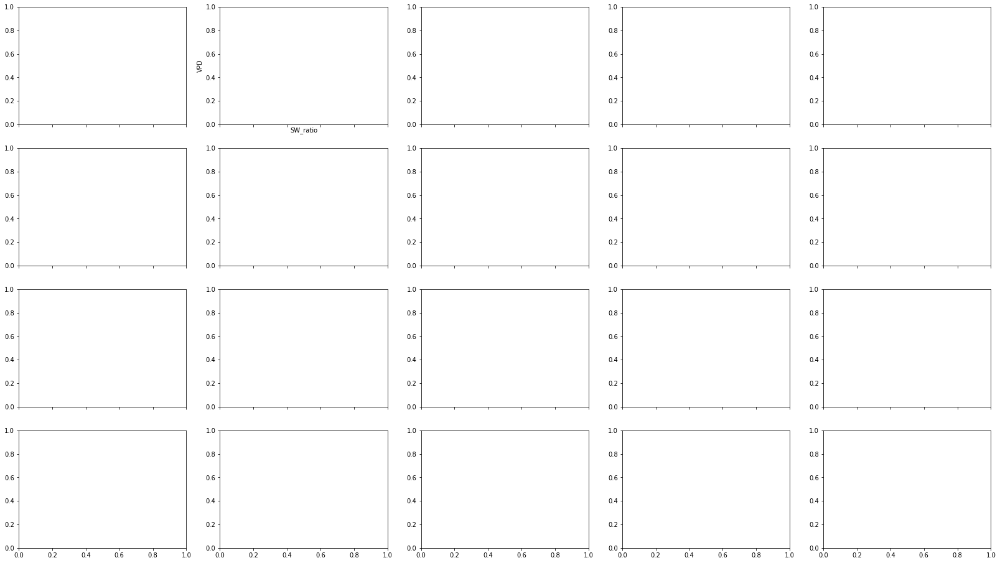

In [166]:
#['VPD','TA','doy_sin','doy_cos']

fig, axes = plt.subplots(4,5, figsize=(28,16), sharex=True)

for i, ax in enumerate(axes.flatten()):
    year = 1996+i
    if str(year) in exp.fitted_models.keys():
        print
        var1 = 'VPD'
        var2 = 'SW_ratio'
        subdata = exp.data[exp.data['Year']==year]

        X = np.zeros([10000,2])
        #value1 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[0], exp.X.max()[0], 100), np.linspace(exp.X.min()[0], exp.X.max()[0], 100))).reshape(-1, 2)[:,0]
        #value2 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[1], exp.X.max()[1], 100), np.linspace(exp.X.min()[1], exp.X.max()[1], 100))).reshape(-1, 2)[:,1]
        value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
        value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
        X[:,0] = value1
        X[:,1] = value2
        #(X[:,2], _), (X[:,3], _) = make_cyclic(np.array((150,365)))
        #make_cyclic(250)

        #X[:,1], X[:,2] = make_cyclic(value2)
        ax.set_xlabel("SW_ratio")
        ax.set_ylabel("VPD")
        new = -exp.fitted_models[str(year)].lue(X)
        #new[new > 0]=0

        ax.scatter(value2, value1, c=new)
        ax.set_title(year, fontsize=12)
        cbar = fig.colorbar(cm.ScalarMappable(cmap='viridis'), ax=ax)
        #plt.colorbar(label="Lue_orth", orientation="horizontal", ax=ax)
    else:
        pass
fig.suptitle(f'Functional relationship of lue factor on {var1} and {var2} at {exp.site}', fontsize=24)


AssertionError: Dimension mis-match of X with fitted X

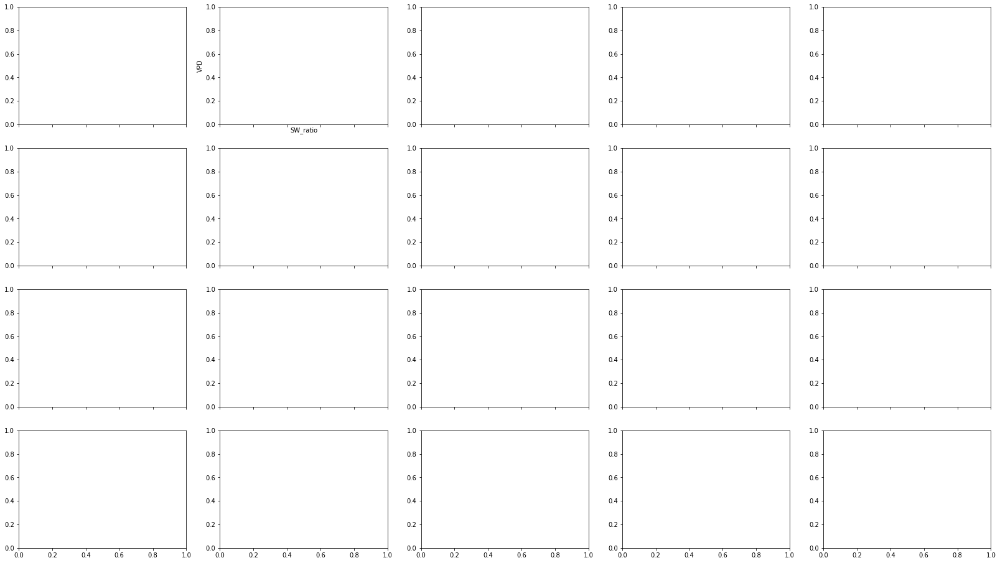

In [167]:
#['VPD', 'SW_ratio', 'doy_sin','doy_cos', 'TA']

fig, axes = plt.subplots(4,5, figsize=(28,16), sharex=True)

for i, ax in enumerate(axes.flatten()):
    year = 1996+i
    if str(year) in exp.fitted_models.keys():
        var1 = 'VPD'
        var2 = 'SW_ratio'
        subdata = exp.data[exp.data['Year']==year]

        X = np.zeros([10000,5])
        #value1 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[0], exp.X.max()[0], 100), np.linspace(exp.X.min()[0], exp.X.max()[0], 100))).reshape(-1, 2)[:,0]
        #value2 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[1], exp.X.max()[1], 100), np.linspace(exp.X.min()[1], exp.X.max()[1], 100))).reshape(-1, 2)[:,1]
        value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
        value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
        X[:,0] = value1
        X[:,1] = value2
        (X[:,2], _), (X[:,3], _) = make_cyclic(np.array((150,365)))
        X[:,4] = subdata['TA'].mean()
                

        #X[:,1], X[:,2] = make_cyclic(value2)
        ax.set_xlabel("SW_ratio")
        ax.set_ylabel("VPD")
        new = -exp.fitted_models[str(year)].lue(X)
        #new[new > 0]=0

        ax.scatter(value2, value1, c=new)
        ax.set_title(year, fontsize=12)
        cbar = fig.colorbar(cm.ScalarMappable(cmap='viridis'), ax=ax)
        #plt.colorbar(label="Lue_orth", orientation="horizontal", ax=ax)
    else:
        pass
fig.suptitle(f'Functional relationship of lue factor on {var1} and {var2} at {exp.site}', fontsize=24)


In [162]:
subdata['VPD'].mean()

Text(0.5, 0.98, 'Functional relationship of lue factor on TA and SW_ratio at NL-Loo')

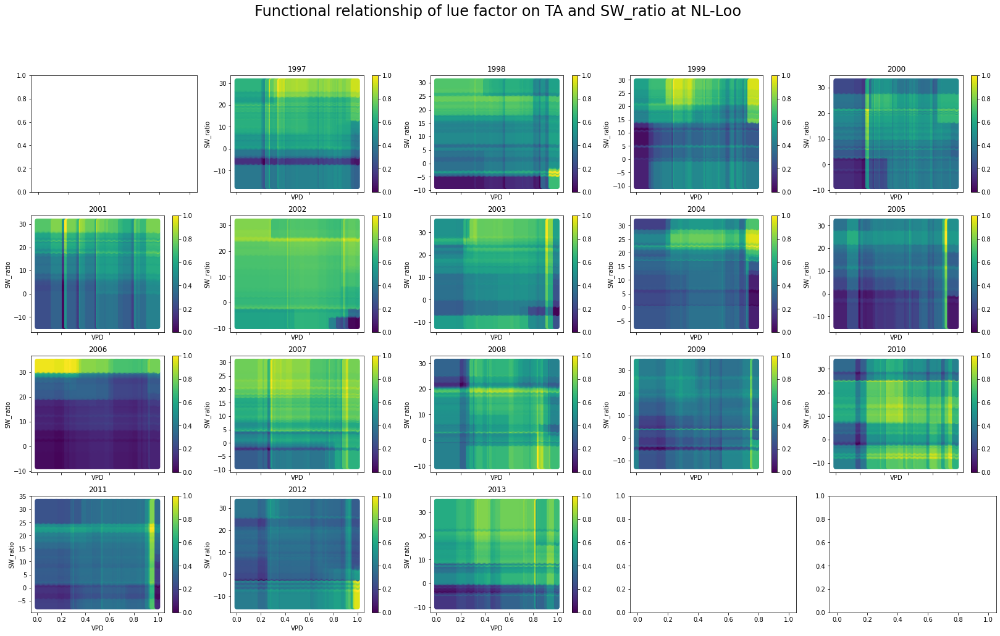

In [170]:
#['VPD', 'SW_ratio', 'doy_sin','doy_cos', 'TA']

fig, axes = plt.subplots(4,5, figsize=(28,16), sharex=True)

for i, ax in enumerate(axes.flatten()):
    year = 1996+i
    if str(year) in exp.fitted_models.keys():
        var1 = 'TA'
        var2 = 'VPD'
        subdata = exp.data[exp.data['Year']==year]

        X = np.zeros([10000,3])
        #value1 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[0], exp.X.max()[0], 100), np.linspace(exp.X.min()[0], exp.X.max()[0], 100))).reshape(-1, 2)[:,0]
        #value2 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[1], exp.X.max()[1], 100), np.linspace(exp.X.min()[1], exp.X.max()[1], 100))).reshape(-1, 2)[:,1]
        value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
        value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
        X[:,2] = value1
        X[:,1] = value2
        #X[:,1], X[:,2] = make_cyclic(value2)
        X[:,0] = subdata['VPD'].mean()
                

        #X[:,1], X[:,2] = make_cyclic(value2)
        ax.set_xlabel("VPD")
        ax.set_ylabel("SW_ratio")
        new = -exp.fitted_models[str(year)].lue(X)
        #new[new > 0]=0

        ax.scatter(value2, value1, c=new)
        ax.set_title(year, fontsize=12)
        cbar = fig.colorbar(cm.ScalarMappable(cmap='viridis'), ax=ax)
        #plt.colorbar(label="Lue_orth", orientation="horizontal", ax=ax)
    else:
        pass
fig.suptitle(f'Functional relationship of lue factor on {var1} and {var2} at {exp.site}', fontsize=24)
#fig.savefig(f'{path}/mean_diurnal_cycle_{flux}_{method}{index}.png', bbox_inches='tight') 


In [77]:
exp.data['SW_DIF']

KeyError: 'SW_DIF'

In [71]:
SW_IN = exp.data['SW_IN']
indices = exp.data['SW_IN'] > exp.data['SW_IN_POT']
SW_IN[indices] = exp.data['SW_IN_POT'][indices]


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


(array([1.20200e+03, 2.80000e+01, 2.20000e+01, 3.90000e+01, 2.50000e+01,
        2.40000e+01, 2.40000e+01, 2.90000e+01, 2.40000e+01, 4.10000e+01,
        3.40000e+01, 4.80000e+01, 5.20000e+01, 6.90000e+01, 8.60000e+01,
        9.20000e+01, 1.09000e+02, 1.60000e+02, 1.92000e+02, 2.95000e+02,
        4.29000e+02, 6.44000e+02, 9.44000e+02, 1.28700e+03, 1.46700e+03,
        1.72300e+03, 1.79500e+03, 1.91800e+03, 1.86700e+03, 1.92300e+03,
        1.91200e+03, 1.89600e+03, 1.92500e+03, 1.84800e+03, 1.92000e+03,
        1.93000e+03, 1.86800e+03, 1.88400e+03, 1.87100e+03, 1.92400e+03,
        1.83300e+03, 1.90000e+03, 1.93000e+03, 1.82800e+03, 1.92100e+03,
        1.89500e+03, 1.89000e+03, 1.80600e+03, 1.85700e+03, 1.87500e+03,
        1.90500e+03, 1.98000e+03, 1.91700e+03, 1.88000e+03, 1.85000e+03,
        1.87700e+03, 1.97400e+03, 2.17800e+03, 2.02700e+03, 2.07300e+03,
        2.26700e+03, 2.07600e+03, 2.16900e+03, 2.12100e+03, 2.11700e+03,
        2.20000e+03, 2.27200e+03, 2.26400e+03, 2.31

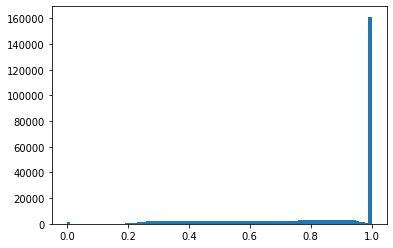

In [145]:
plt.hist(exp.data['SW_ratio'], bins=100)

In [59]:
1e-10

In [37]:
#['VPD','TA','doy_sin','doy_cos']
year = 2007
var1 = 'VPD'
var2 = 'TA'
var3 = 'doy'
subdata = exp.data[exp.data['Year']==year]

X = np.zeros([10000,4])
#value1 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[0], exp.X.max()[0], 100), np.linspace(exp.X.min()[0], exp.X.max()[0], 100))).reshape(-1, 2)[:,0]
#value2 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[1], exp.X.max()[1], 100), np.linspace(exp.X.min()[1], exp.X.max()[1], 100))).reshape(-1, 2)[:,1]
value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
value3 = np.dstack(np.meshgrid(np.linspace(subdata[var3].min(), subdata[var3].max(), 100), np.linspace(subdata[var3].min(), subdata[var3].max(), 100))).reshape(-1, 2)[:,1]
X[:,0] = value1
X[:,1] = value2.mean()

#make_cyclic(250)

X[:,2], X[:,3] = make_cyclic(value3)

plt.scatter(value3, value1, c=exp.fitted_models[str(year)].lue(X))
plt.colorbar(label="Lue_orth", orientation="horizontal")


AssertionError: Dimension mis-match of X with fitted X

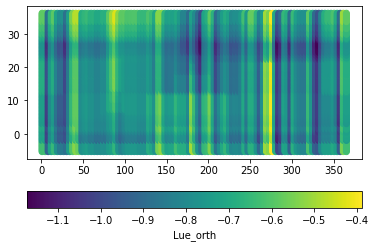

In [67]:
#['VPD','TA','doy_sin','doy_cos']
year = 2006
var1 = 'VPD'
var2 = 'TA'
var3 = 'doy'
subdata = exp.data[exp.data['Year']==year]

X = np.zeros([10000,4])
#value1 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[0], exp.X.max()[0], 100), np.linspace(exp.X.min()[0], exp.X.max()[0], 100))).reshape(-1, 2)[:,0]
#value2 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[1], exp.X.max()[1], 100), np.linspace(exp.X.min()[1], exp.X.max()[1], 100))).reshape(-1, 2)[:,1]
value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,0]
value3 = np.dstack(np.meshgrid(np.linspace(subdata[var3].min(), subdata[var3].max(), 100), np.linspace(subdata[var3].min(), subdata[var3].max(), 100))).reshape(-1, 2)[:,1]
X[:,0] = value1.mean()
X[:,1] = value2

#make_cyclic(250)

X[:,2], X[:,3] = make_cyclic(value3)

plt.scatter(value3, value2, c=exp.fitted_models[str(year)].lue(X))
plt.colorbar(label="Lue_orth", orientation="horizontal")


#SWC

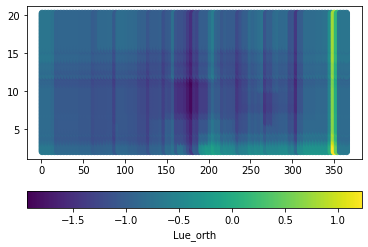

In [17]:
year = 2010
var1 = 'SWC_1'
var2 = 'doy'
subdata = exp.data[exp.data['Year']==year]

X = np.zeros([10000,3])
#value1 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[0], exp.X.max()[0], 100), np.linspace(exp.X.min()[0], exp.X.max()[0], 100))).reshape(-1, 2)[:,0]
#value2 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[1], exp.X.max()[1], 100), np.linspace(exp.X.min()[1], exp.X.max()[1], 100))).reshape(-1, 2)[:,1]
value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
X[:,0] = value1
X[:,1] = value2
X[:,1], X[:,2] = make_cyclic(value2)

new = exp.fitted_models[str(year)].lue(X)
#new[new > 0] = 0new[new < -1.8] = -1.8

plt.scatter(value2, value1, c=new)
plt.colorbar(label="Lue_orth", orientation="horizontal")


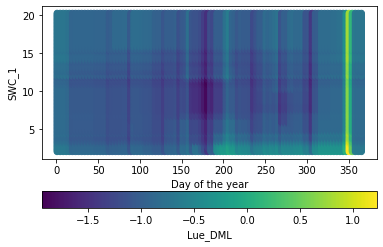

In [19]:
year = 2010
var1 = 'SWC_1'
var2 = 'doy'
subdata = exp.data[exp.data['Year']==year]

X = np.zeros([10000,3])
#value1 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[0], exp.X.max()[0], 100), np.linspace(exp.X.min()[0], exp.X.max()[0], 100))).reshape(-1, 2)[:,0]
#value2 = np.dstack(np.meshgrid(np.linspace(exp.X.min()[1], exp.X.max()[1], 100), np.linspace(exp.X.min()[1], exp.X.max()[1], 100))).reshape(-1, 2)[:,1]
value1 = np.dstack(np.meshgrid(np.linspace(subdata[var1].min(), subdata[var1].max(), 100), np.linspace(subdata[var1].min(), subdata[var1].max(), 100))).reshape(-1, 2)[:,0]
value2 = np.dstack(np.meshgrid(np.linspace(subdata[var2].min(), subdata[var2].max(), 100), np.linspace(subdata[var2].min(), subdata[var2].max(), 100))).reshape(-1, 2)[:,1]
X[:,0] = value1
X[:,1] = value2
X[:,1], X[:,2] = make_cyclic(value2)

new = exp.fitted_models[str(year)].lue(X)
#new[new > 0] = 0

plt.xlabel("Day of the year")
plt.ylabel("SWC_1")


plt.scatter(value2, value1, c=new)
plt.colorbar(label="Lue_DML", orientation="horizontal")



In [120]:
['P', 'SWC_1']
['TA_s', 'SWC_1_s','VPD_s','SWC_2_s', 'WS_s']

['TA_s', 'SWC_1_s', 'VPD_s', 'SWC_2_s', 'WS_s']

In [327]:
exp.light_response_curve()

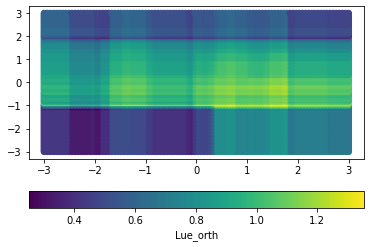

In [324]:
plt.scatter(value1, value2, c=exp.fitted_models['2007'].lue(X))
plt.colorbar(label="Lue_orth", orientation="horizontal")

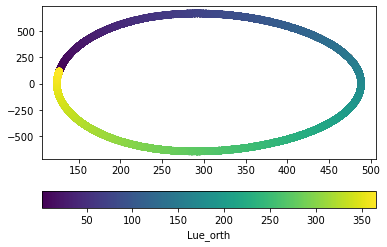

In [325]:
plt.scatter(exp.data['SW_POT_sm'], exp.data['SW_POT_sm_diff'], c=exp.data['doy'])
plt.colorbar(label="Lue_orth", orientation="horizontal")

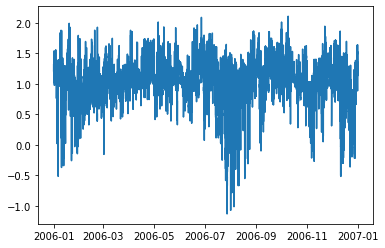

In [ ]:
plt.plot(exp.data[exp.data.Year == 2006].LUE_orth)

In [249]:
tables, dictionary = numerical_cross_consistency("FPDML_FR-LBr_2023-02-02_5", syn=False)

Filter out according to relevant_variables.


In [250]:
tables['GPP']

,method 1,method 2,R2,RMSE,bias,R2_rm_daily,RMSE_rm_daily
0,DT,orth,0.93 (0.91/0.93),1.75 (1.72/1.93),-0.26 (-0.35/0.02),0.94 (0.93/0.94),1.41 (1.37/1.57)
1,DT,ann,0.9 (0.9/0.91),1.91 (1.82/2.15),-0.13 (-0.14/0.22),0.92 (0.92/0.93),1.54 (1.5/1.72)
2,NT,orth,0.78 (0.77/0.81),3.66 (3.14/4.0),0.17 (0.08/0.22),0.76 (0.75/0.8),3.47 (2.95/3.8)
3,NT,ann,0.8 (0.8/0.83),3.37 (2.9/3.74),0.31 (0.27/0.42),0.78 (0.78/0.82),3.18 (2.69/3.53)
4,DT,NT,0.71 (0.67/0.72),3.7 (3.29/4.09),-0.44 (-0.57/-0.06),0.67 (0.63/0.7),3.47 (3.03/3.82)
5,ann,orth,0.91 (0.91/0.93),1.9 (1.82/1.92),-0.26 (-0.26/-0.2),0.92 (0.92/0.93),1.59 (1.53/1.62)


In [251]:
tables['RECO']

,method 1,method 2,R2,RMSE,bias,R2_rm_daily,RMSE_rm_daily
0,DT,orth,-0.09 (-0.23/-0.03),2.0 (1.98/2.19),-0.54 (-0.76/-0.18),-4.7 (-5.32/-3.98),1.23 (1.23/1.41)
1,DT,ann,-0.1 (-0.18/-0.04),1.97 (1.95/2.18),-0.47 (-0.61/-0.11),-2.61 (-4.63/-2.08),1.24 (1.11/1.26)
2,NT,orth,0.04 (0.0/0.16),1.79 (1.69/1.97),0.18 (0.11/0.21),-7.57 (-8.7/-5.89),1.24 (1.21/1.42)
3,NT,ann,0.29 (0.28/0.34),1.57 (1.54/1.64),0.25 (0.18/0.36),-4.53 (-6.91/-3.66),1.14 (1.1/1.21)
4,DT,NT,0.22 (0.11/0.23),1.71 (1.69/1.91),-0.72 (-0.97/-0.29),0.54 (0.46/0.58),0.4 (0.34/0.46)
5,ann,orth,0.03 (0.02/0.11),2.02 (1.92/2.07),-0.08 (-0.16/-0.07),-2.0 (-2.08/-1.7),1.6 (1.45/1.62)


In [252]:
tables['NEE']

,method 1,method 2,R2,RMSE,bias,R2_rm_daily,RMSE_rm_daily
0,DT,orth,0.91 (0.91/0.93),1.72 (1.7/1.74),-0.27 (-0.42/-0.2),0.93 (0.92/0.94),1.37 (1.37/1.42)
1,DT,ann,0.89 (0.87/0.9),2.05 (2.0/2.08),-0.34 (-0.46/-0.33),0.9 (0.87/0.92),1.76 (1.72/1.79)
2,NT,orth,0.77 (0.77/0.81),3.47 (2.98/3.78),0.01 (-0.01/0.03),0.77 (0.75/0.8),3.33 (2.83/3.64)
3,NT,ann,0.82 (0.82/0.87),2.95 (2.39/3.34),-0.06 (-0.09/-0.06),0.8 (0.8/0.85),2.95 (2.39/3.32)
4,DT,NT,0.67 (0.65/0.7),3.55 (3.15/3.92),-0.28 (-0.4/-0.23),0.65 (0.61/0.68),3.4 (2.97/3.75)
5,ann,orth,0.92 (0.91/0.93),1.86 (1.83/1.91),0.07 (0.05/0.13),0.92 (0.92/0.93),1.61 (1.61/1.64)


In [141]:
exp.__dict__

{'PATH': PosixPath('/home/kaicohrs/Repositories/dml-4-fluxes/results/FPDML_FR-LBr_2023-02-02_1'),
 'experiment_config': {'experiment_type': 'flux_partitioning',
  'comment': 'Flux partitioning',
  'extrapolate': False,
  'seed': 1000},
 'dataset_config': {'site_name': 'FR-LBr',
  'syn': False,
  'version': 'simple',
  'Q10': 1.5,
  'relnoise': 0,
  'pre_computed': False,
  'transform_T': False,
  'month_wise': False,
  'moving_window': [3, 3],
  'delta': 'heuristic7',
  'X': ['TA_s', 'SWC_1_s', 'VPD_s', 'SWC_2_s', 'WS_s'],
  'W': ['doy_sin_s', 'doy_cos_s'],
  'years': 'all',
  'test_scenario': True,
  'RMSE': True,
  'alternative_fluxes': None,
  'alternative_treatment': None,
  'good_years_only': True,
  'store_parameter': True},
 'model_configs': {'y': {'model': 'GradientBoostingRegressor',
   'min_samples_split': 5,
   'min_samples_leaf': 40,
   'max_depth': 1,
   'n_estimators': 200},
  't': {'model': 'GradientBoostingRegressor',
   'min_samples_split': 5,
   'min_samples_leaf': 40

In [ ]:
exp = experiment.FluxPartDML()
exp.new(site)
exp.configs(experiment_config, dataset_config, model_configs)
exp.prepare_data()
exp.fit_models()
#exp.all_analysis()

In [ ]:
exp.data['']

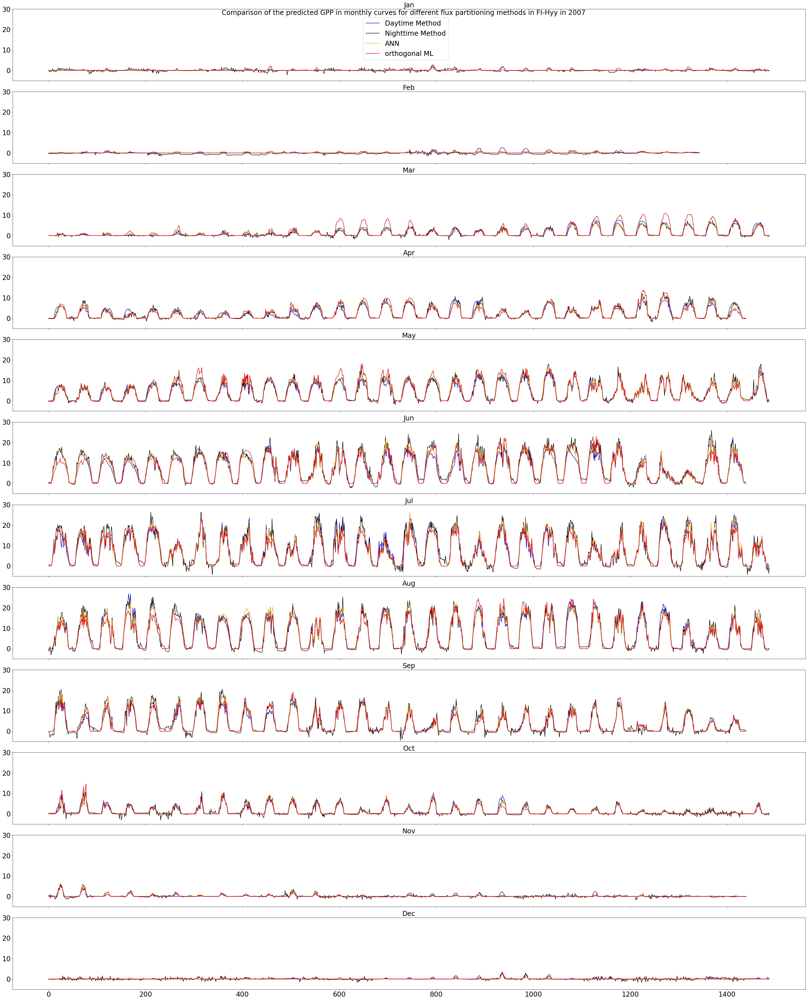

In [61]:
monthly_curves(exp.data, site=site, year=2007, flux="GPP", res=False)

In [10]:
exp.experiment_name

'FPDML_FI-Hyy_2023-01-31_3'

In [147]:
doy = exp.data['doy']
X = exp.data[['TA', 'CWD', 'VPD']]
rg = exp.data['SW_IN']

y = exp.light_response_curve.predict(rg, X, doy)

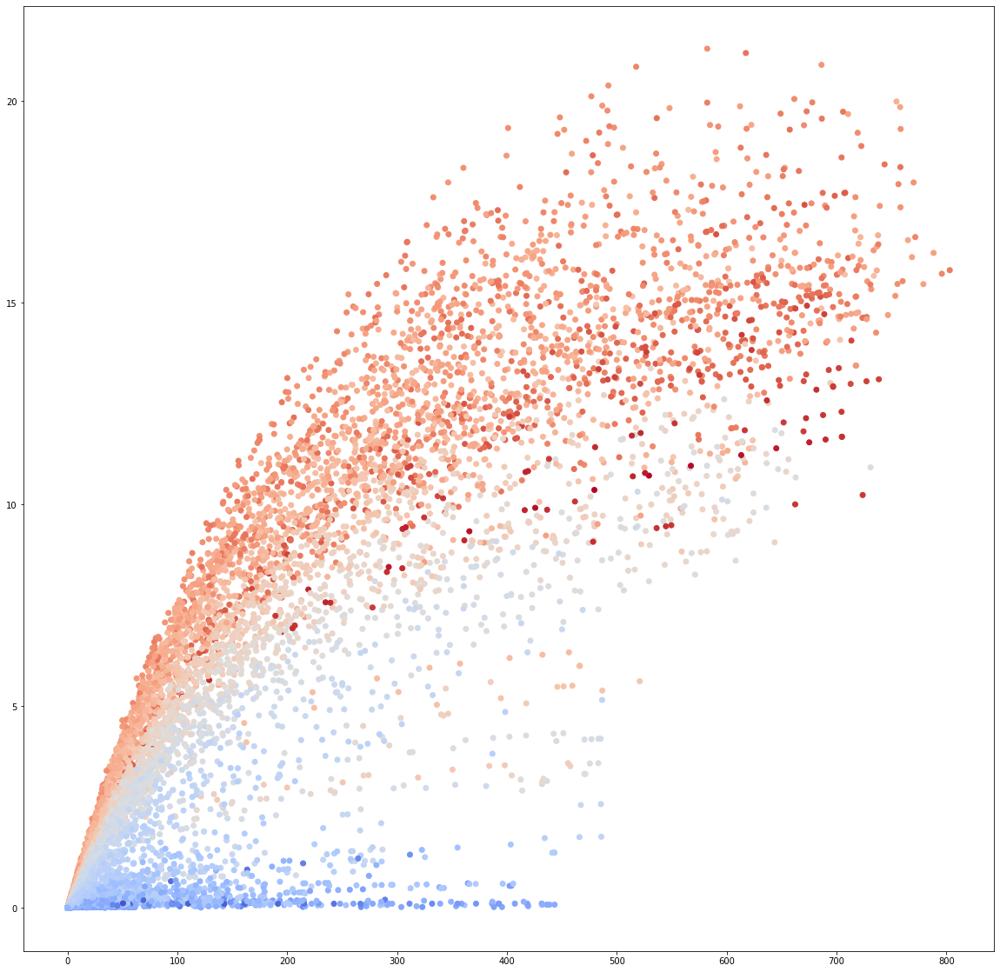

In [148]:
fig, ax = plt.subplots(1, 1, figsize = (20,20))

ax.scatter(exp.data['SW_IN'], y, c = X['TA'], cmap='coolwarm')

In [130]:
rg = np.linspace(0, 1000, 100)
W = np.zeros((len(rg),3))

#doy = exp.data['doy']
W[:,0] = X['TA'].mean()
W[:,1] = X['CWD'].mean()
W[:,2] = X['VPD'].mean()
doy = 177*np.ones(len(rg))

In [132]:
y = exp.light_response_curve.predict(rg, W, doy)

In [133]:
from matplotlib import cm

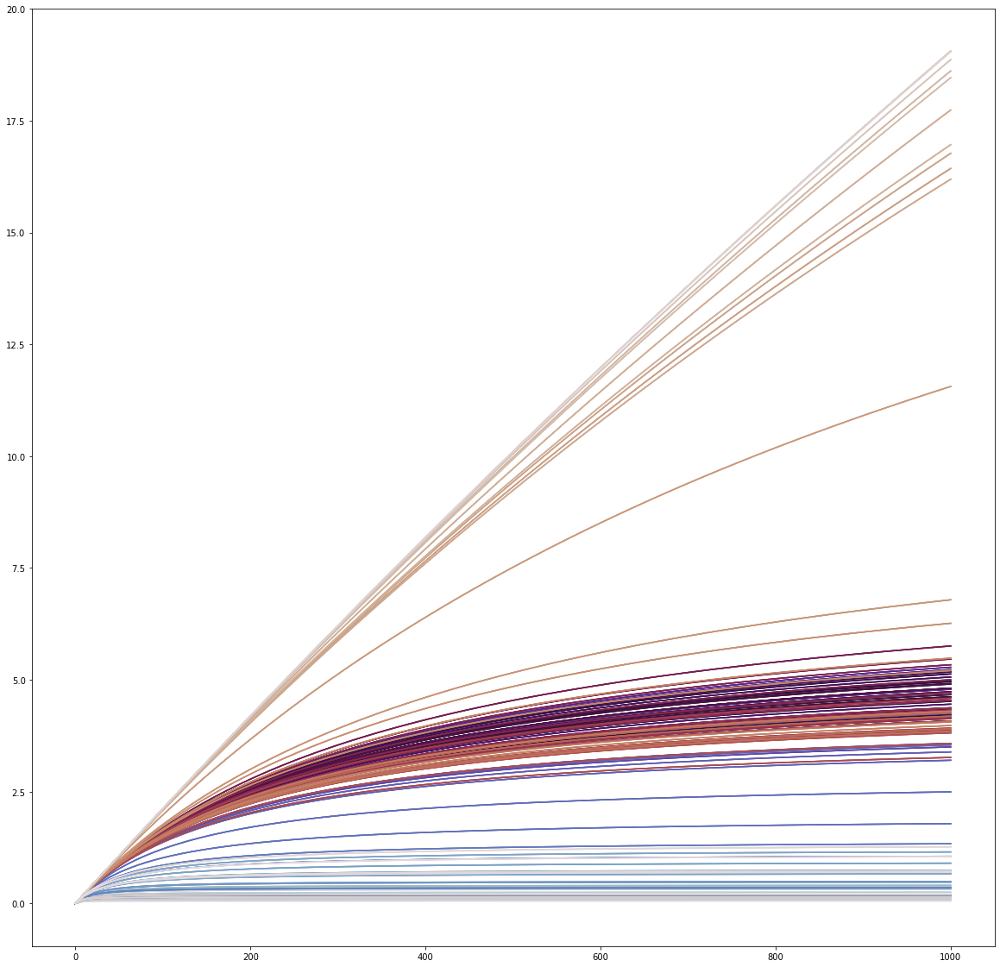

In [157]:
rg = np.linspace(0, 1000, 100)
W = np.zeros((len(rg),3))

#doy = exp.data['doy']
W[:,0] = X['TA'].mean()
W[:,1] = X['CWD'].mean()
W[:,2] = X['VPD'].max()
doy = 20*np.ones(len(rg))

fig, ax = plt.subplots(1, 1, figsize = (20,20))
cmap = cm.get_cmap("twilight")
doys = range(0, 365)
colors = cmap(np.array(range(len(doys)))/len(doys))
for i, day in enumerate(doys):
    doy = day*np.ones(len(rg))
    y = exp.light_response_curve.predict(rg, W, doy)
    ax.plot(rg, y, c = colors[i])


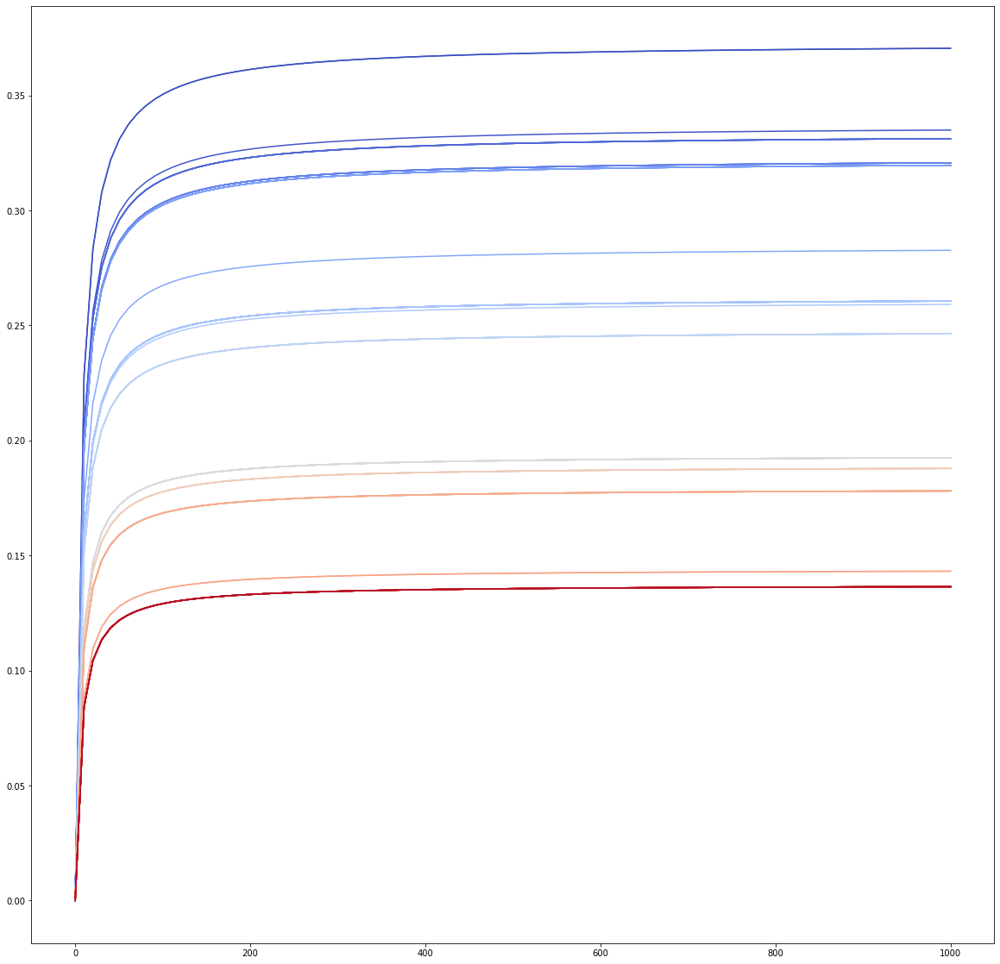

In [153]:
var = 'VPD'
rg = np.linspace(0, 1000, 100)
t = np.linspace(X[var].min(), X[var].max(), 100)
W = np.zeros((len(t),3))

#doy = exp.data['doy']
W[:,0] = X['TA'].mean()
W[:,1] = X['CWD'].mean()
W[:,2] = X['VPD'].mean()
doy = 20*np.ones(len(t))

fig, ax = plt.subplots(1, 1, figsize = (20,20))
cmap = cm.get_cmap("coolwarm")
colors = cmap(np.array(range(len(t)))/len(t))
for i, T in enumerate(list(t)):
    W[:,2] = T
    y = exp.light_response_curve.predict(rg, W, doy)
    ax.plot(rg, y, c = colors[i])


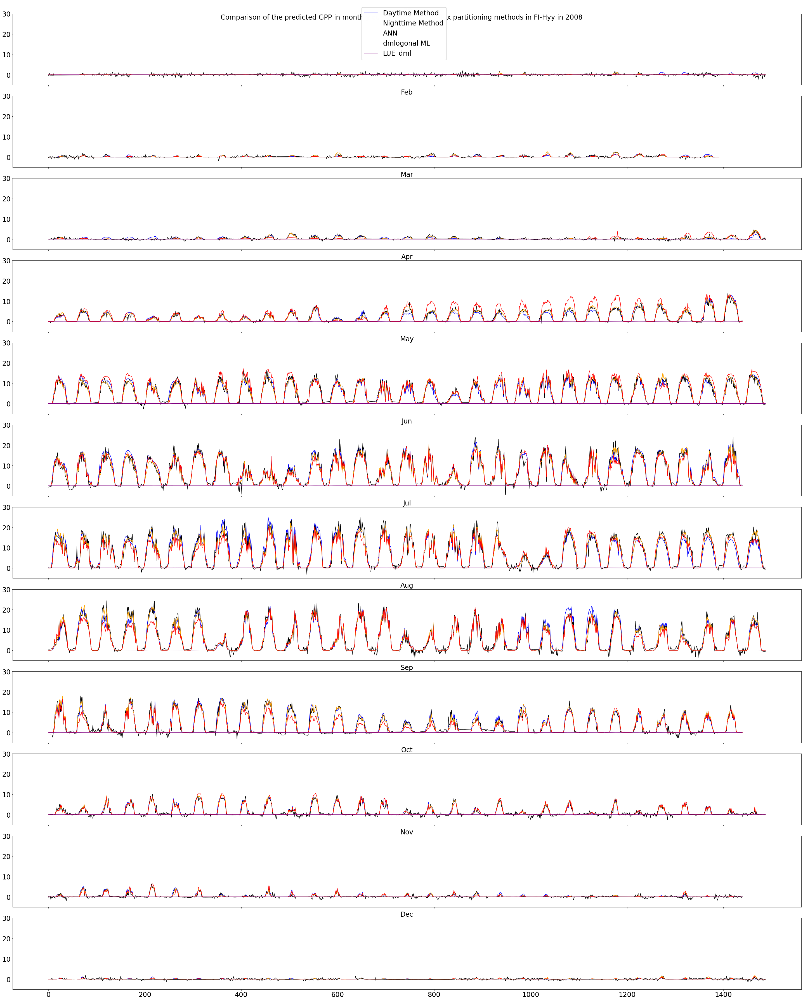

In [158]:
monthly_curves(exp.data, site=site, year=2008, flux="GPP", res=False, input='LUE_dml')

In [66]:
if exp.data is not None:
    print('miau')

miau


In [59]:
exp.dml.est.score_

In [29]:
from econml.cate_interpreter import SingleTreeCateInterpreter
import shap

In [100]:
intrp = SingleTreeCateInterpreter(include_model_uncertainty=False, max_depth=2, min_samples_leaf=10)

In [39]:
intrp.interpret(exp.dml.est, exp.X)

Criterion 'mse' was deprecated in v1.0 and will be removed in version 1.2. Use `criterion='squared_error'` which is equivalent.


In [40]:
exp.X

,VPD_n,TA_n,wdefcum_n
192865,-0.701165,-0.771592,0.708514
192866,-0.703418,-0.792359,0.707885
192867,-0.702917,-0.806636,0.706723
192868,-0.705170,-0.820913,0.705948
192869,-0.706671,-0.836488,0.704709
...,...,...,...
210379,-0.605307,-1.041560,0.710837
210380,-0.585535,-1.014303,0.710423
210381,-0.595546,-1.011707,0.710179
210382,-0.587037,-1.009112,0.709878


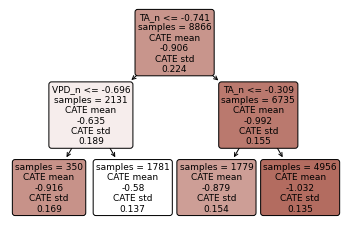

In [43]:
intrp.plot(feature_names=['VPD_n', 'TA_n', 'wdefcum_n'], fontsize=9)

In [46]:
shap_values = exp.dml.est.shap_values(exp.X)

ind=0
shap.plots.force(shap_values["Y0"]["T0"][ind], matplotlib=True)
# global view: explain hetergoeneity for a sample of dataset
shap.summary_plot(shap_values['Y0']['T0'])


KeyError: 'T0'

In [50]:
shap_values

defaultdict(dict,
            {'NEE': {'T': .values =
  array([[-0.26697645,  0.17808856,  0.05600489],
         [-0.47565571,  0.18530181,  0.05600489],
         [-0.47565571,  0.18530181,  0.05600489],
         ...,
         [ 0.01416894,  0.47563707,  0.00090998],
         [ 0.00332325,  0.4784246 , -0.00342903],
         [-0.00379138,  0.4784246 , -0.00725998]])
  
  .base_values =
  array([-0.91969637, -0.91969637, -0.91969637, ..., -0.91969637,
         -0.91969637, -0.91969637])
  
  .data =
  array([[-0.7011651 , -0.77159209,  0.70851405],
         [-0.70341763, -0.79235882,  0.7078847 ],
         [-0.70291707, -0.80663595,  0.70672277],
         ...,
         [-0.59554641, -1.01170743,  0.71017937],
         [-0.58703685, -1.00911159,  0.70987848],
         [-0.57477307, -1.00651575,  0.70959166]])}})

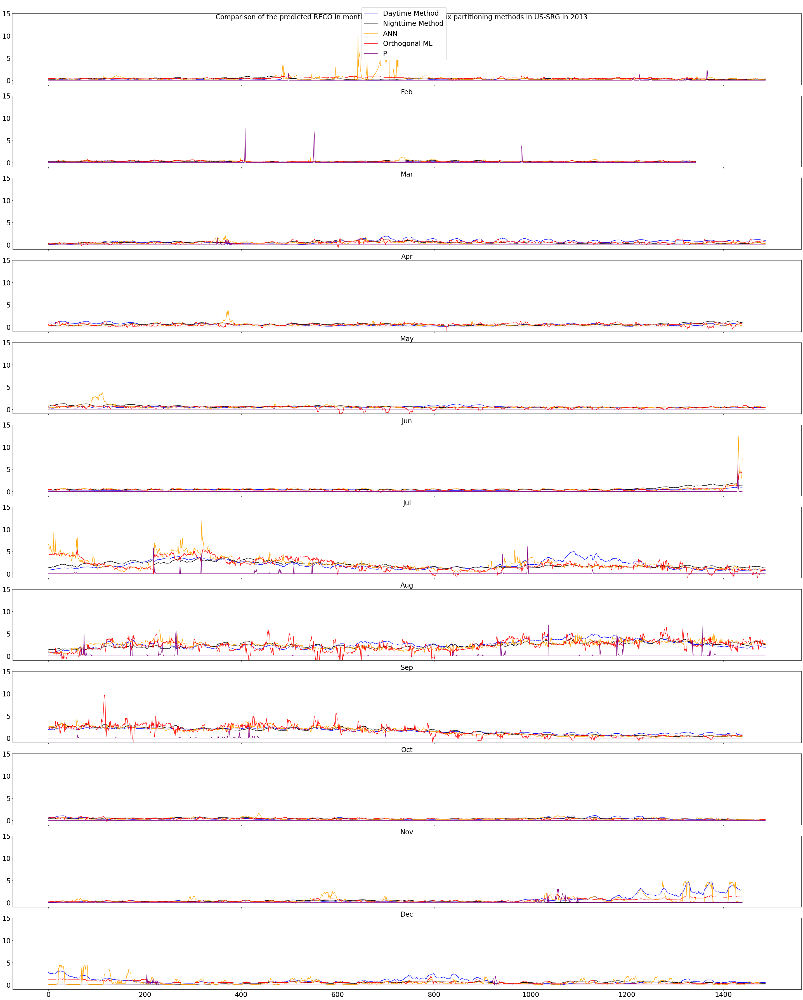

In [10]:
exp.data["site"] = site
monthly_curves(exp.data, site=site, year=2013, flux="RECO", res=False, input='P')

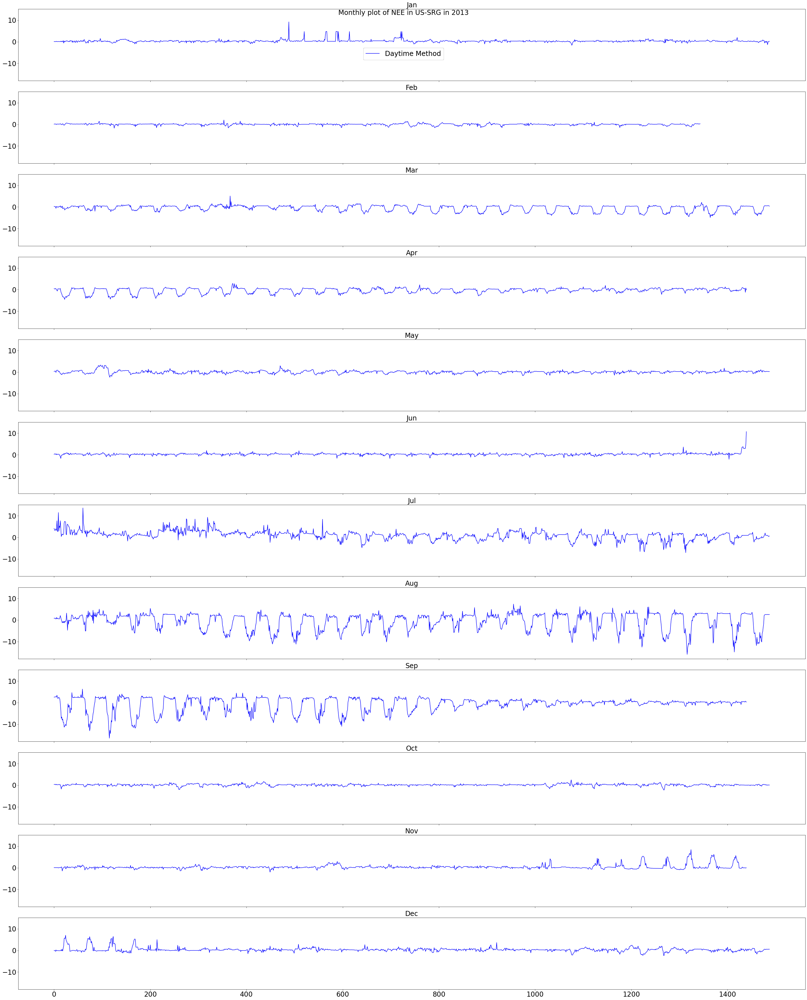

In [82]:
monthly_curves_input(exp.data, site=site, year=2013, input="NEE", res=False)

In [71]:
exp.rm_experiment()

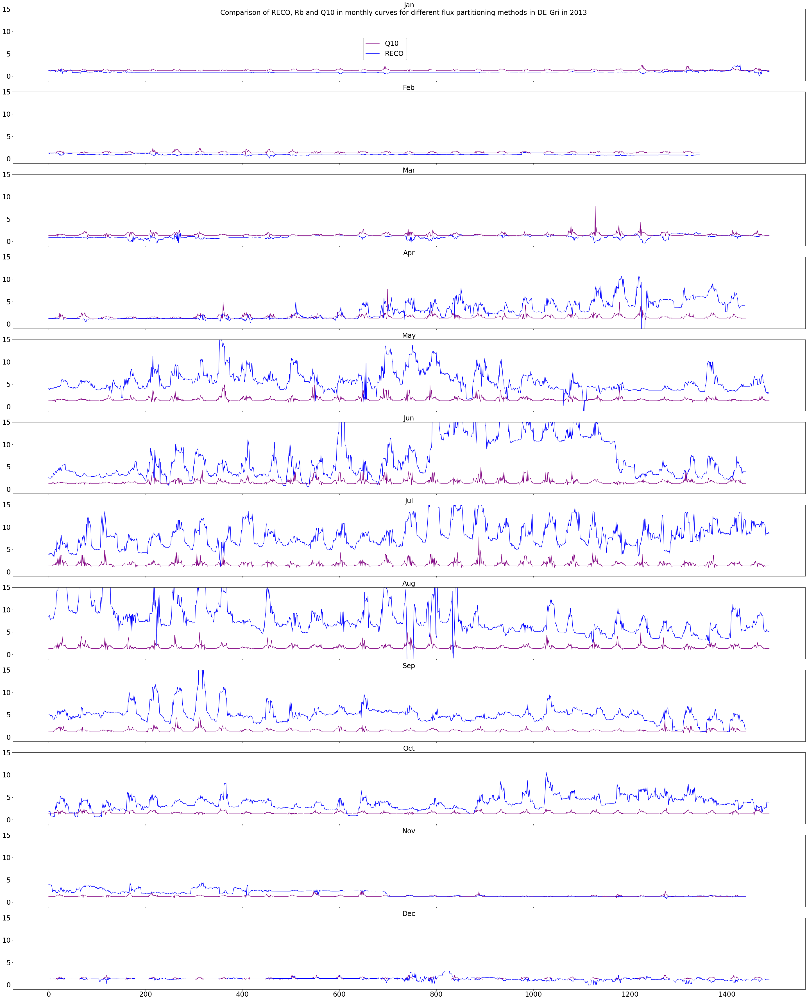

In [72]:
monthly_Q10_model_curves(exp.data, site=site, year=2013, res=False)

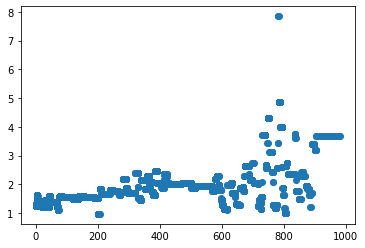

In [73]:
plt.scatter(exp.data["SW_IN"], exp.data["Q10"])

In [99]:
import shap

In [17]:
exp.RECO_orth_model.X.shape

AttributeError: 'FluxPartDML' object has no attribute 'RECO_orth_model'

In [123]:
shap_values = exp.RECO_orth_model.est.shap_values(exp.RECO_orth_model.X)


In [16]:
shap.summary_plot(shap_values['Y0']['T0'], feature_names = ['VPD', 'wdefcum','SW_IN'])

NameError: name 'shap' is not defined

In [2]:
from dml4fluxes.analysis.postprocessing import evaluate, timely_averages, condense

In [5]:
# Imports
%load_ext autoreload
%autoreload 2

import sys
# sys.path.append('../')

import numpy as np

import matplotlib.pyplot as plt
import scipy.stats as stats

import pandas as pd
from sklearn.metrics import r2_score, mean_squared_error

from dml4fluxes.experiments import experiment, experiment_utils
from dml4fluxes.analysis.visualization import *
from dml4fluxes.datasets.preprocessing import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [6]:
only_one_year = ["CH-Cha",
                    "Be-Lon",
                    "DE-Gri",
                    "DE-Hai",
                    "DK-Sor",
                    "FI-Hyy",
                    "FR-FBn",
                    "ES-Abr",
                    ]

In [7]:
# the number of row in each data frame
# you can put any value here according to your situation
chunksize = 10000

# the list that contains all the dataframes
list_of_dataframes = []

for df in pd.read_csv('/home/kaicohrs/Repositories/results/DML_sota/analysis_data.csv', chunksize=chunksize):
    # process your data frame here
    # then add the current data frame into the list
    #df = df.loc[(df['site']=='US-SRG'),:]
    #df = df.loc[np.isin(df['site'],only_one_year),:]
    #df = df.loc[(df['quality_mask']!=0),:]
    #df = df.loc[(df['MeasurementNEE_mask']!=0),:]
    df = df[['doy', 'Year', 'RECO_ann', 'RECO_DT', 'quality_mask',
            'Month', 'site', 'RECO_orth', 'NEE_orth', 'Time', 'NEE_ann', 'GPP_ann', 'GPP_DT', 
            'MeasurementNEE_mask', 'NEE',
            'QC', 'NIGHT', 'NEE_DT', 'RECO_NT', 'GPP_orth', 'RECO_orth_res',
            'GPP_NT', 'NEE_NT',]]
    list_of_dataframes.append(df)

# if you want all the dataframes together, here it is
data = pd.concat(list_of_dataframes)


In [8]:
daily_avg = data.groupby(['site', 'Year', 'doy'])['quality_mask'].mean()
daily_avg = daily_avg.rename('quality_mask_daily')
data = data.join(daily_avg, on=['site', 'Year', 'doy'])
data['quality_mask_daily'] = data['quality_mask_daily'].apply(lambda x: 0 if x < 0.5 else 1)

In [9]:
data = data.loc[(data['quality_mask']!=0),:]
data = data.loc[(data['QC']==0),:]
data = data.loc[(data['MeasurementNEE_mask']!=0),:]
data = data.loc[(~np.isnan(data['RECO_ann'])),:]
data = data.loc[(data['quality_mask_daily']!=0),:]

In [68]:
data

,doy,Year,RECO_ann,RECO_DT,quality_mask,Month,site,RECO_orth,NEE_orth,Time,...,NIGHT,NEE_DT,RECO_NT,GPP_orth,RECO_orth_res,GPP_NT,NEE_NT,quality_mask_daily,GPP_orth_daily_avg,GPP_NT_daily_avg
26400,5,2002,0.767843,1.207280,1,1,US-MMS,0.803424,0.803424,00:15:00,...,1.0,1.207280,0.830833,0.000000,0.755824,0.075009,0.755824,1,0.029182,0.079059
26401,5,2002,0.727260,1.200410,1,1,US-MMS,0.803424,0.803424,01:15:00,...,1.0,1.200410,0.822565,0.000000,2.276770,-1.454210,2.276775,1,0.029182,0.079059
26402,5,2002,0.727814,1.193180,1,1,US-MMS,0.833588,0.833588,02:15:00,...,1.0,1.193180,0.813924,0.000000,-0.004097,0.818022,-0.004098,1,0.029182,0.079059
26403,5,2002,0.742245,1.190440,1,1,US-MMS,0.842868,0.842868,03:15:00,...,1.0,1.190440,0.809417,0.000000,1.134620,-0.325202,1.134619,1,0.029182,0.079059
26404,5,2002,0.748090,1.187720,1,1,US-MMS,0.842868,0.842868,04:15:00,...,1.0,1.187720,0.804912,0.000000,0.304329,0.500583,0.304329,1,0.029182,0.079059
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7056922,365,2006,0.225945,0.159948,1,12,US-ARM,0.049199,-0.038790,17:15:00,...,0.0,0.088811,0.178122,0.087989,-0.084011,0.350122,-0.172000,1,0.278260,-0.270078
7056923,365,2006,0.194369,0.151974,1,12,US-ARM,0.049199,0.049199,17:45:00,...,1.0,0.151974,0.174523,0.000000,-0.467444,0.641967,-0.467444,1,0.278260,-0.270078
7056928,365,2006,0.235038,0.144899,1,12,US-ARM,0.049199,0.049199,20:15:00,...,1.0,0.144899,0.171234,0.000000,-0.256889,0.428123,-0.256889,1,0.278260,-0.270078
7056929,365,2006,0.214137,0.141250,1,12,US-ARM,0.064012,0.064012,20:45:00,...,1.0,0.141250,0.169500,0.000000,-0.600222,0.769722,-0.600222,1,0.278260,-0.270078


In [77]:
r2_score(site_year[flux + "_" + method_1]-daily_avg_1, site_year[flux + "_" + method_2]-daily_avg_2)

ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

In [10]:
data = data.drop("GPP_orth_daily_avg", axis=1)
data = data.drop("GPP_NT_daily_avg", axis=1)


KeyError: "['GPP_orth_daily_avg'] not found in axis"

In [74]:
results_R2 = list()
results_RMSE = list()
results_bias = list()

flux = "NEE"
method_1 = "DT"
method_2 = "NT"

without_daily_avg = False
try:
    daily_avg = data.groupby(['site', 'Year', 'doy'])[flux + "_" + method_1].mean()
    daily_avg = daily_avg.rename(flux + "_" + method_1+"_daily_avg")
    data = data.join(daily_avg, on=['site', 'Year', 'doy'])
except:
    pass
try:
    daily_avg = data.groupby(['site', 'Year', 'doy'])[flux + "_" + method_2].mean()
    daily_avg = daily_avg.rename(flux + "_" + method_2+"_daily_avg")
    data = data.join(daily_avg, on=['site', 'Year', 'doy'])
except:
    pass

for site in data["site"].unique():
    for year in data.loc[(data["site"] == site),'Year'].unique():
        site_year = data.loc[(data["site"] == site) & (data['Year'] == year),:]
        if without_daily_avg:
            daily_avg_1 = site_year[flux + "_" + method_1+"_daily_avg"]
            daily_avg_2 = site_year[flux + "_" + method_2+"_daily_avg"]
        else:
            daily_avg_1 = 0
            daily_avg_2 = 0

        results_R2.append(r2_score(site_year[flux + "_" + method_1]-daily_avg_1, site_year[flux + "_" + method_2]-daily_avg_2))
        results_RMSE.append(mean_squared_error(site_year[flux + "_" + method_1]-daily_avg_1, site_year[flux + "_" + method_2]-daily_avg_2, squared=False))
        results_bias.append(np.mean(site_year[flux + "_" + method_1]-site_year[flux + "_" + method_2]))

np.median(results_RMSE), np.quantile(results_RMSE, 0.25), np.quantile(results_RMSE, 0.75) 
np.median(results_R2), np.quantile(results_R2, 0.25), np.quantile(results_R2, 0.75)
np.median(results_bias).round(2), np.quantile(results_bias, 0.25).round(2), np.quantile(results_bias, 0.75).round(2)

In [75]:
np.median(results_R2).round(2), np.quantile(results_R2, 0.25).round(2), np.quantile(results_R2, 0.75).round(2)

In [76]:
np.median(results_RMSE).round(2), np.quantile(results_RMSE, 0.25).round(2), np.quantile(results_RMSE, 0.75).round(2) 

In [86]:
data.columns

Index(['doy', 'Year', 'RECO_ann', 'RECO_DT', 'quality_mask', 'Month', 'site',
       'RECO_orth', 'NEE_orth', 'Time', 'NEE_ann', 'GPP_ann', 'GPP_DT',
       'MeasurementNEE_mask', 'NEE', 'QC', 'NIGHT', 'NEE_DT', 'RECO_NT',
       'GPP_orth', 'RECO_orth_res', 'GPP_NT', 'NEE_NT', 'quality_mask_daily',
       'RECO_orth_daily_avg', 'RECO_NT_daily_avg', 'RECO_DT_daily_avg',
       'RECO_ann_daily_avg', 'GPP_DT_daily_avg', 'GPP_orth_daily_avg',
       'GPP_ann_daily_avg', 'GPP_NT_daily_avg', 'NEE_DT_daily_avg',
       'NEE_orth_daily_avg', 'NEE_ann_daily_avg', 'NEE_NT_daily_avg',
       'quality_mask_yearly', 'soy', 'quality_mask_seasonal',
       'quality_mask_daily_anomalies', 'quality_mask_seasonal_without_yearly'],
      dtype='object')

In [84]:
data = dml4fluxes.datasets.preprocessing.get_average_quality_mask(data)

In [94]:
data= dml4fluxes.analysis.postprocessing.timely_averages(data)

In [97]:
!pwd

/home/kaicohrs/Repositories/dml-4-fluxes/scripts/notebooks


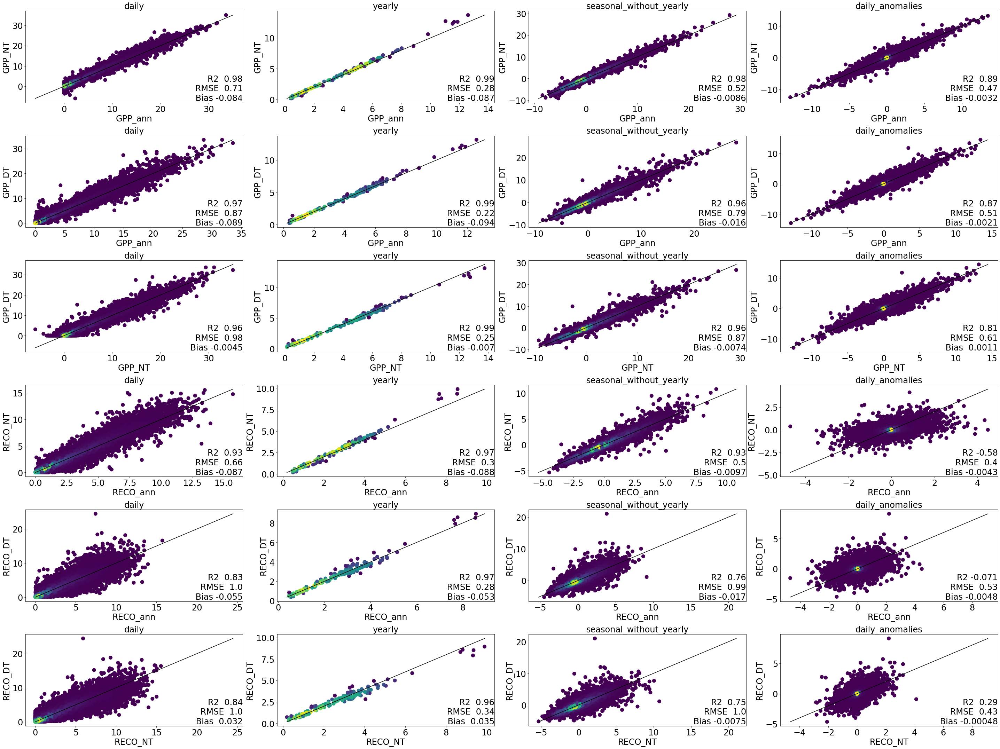

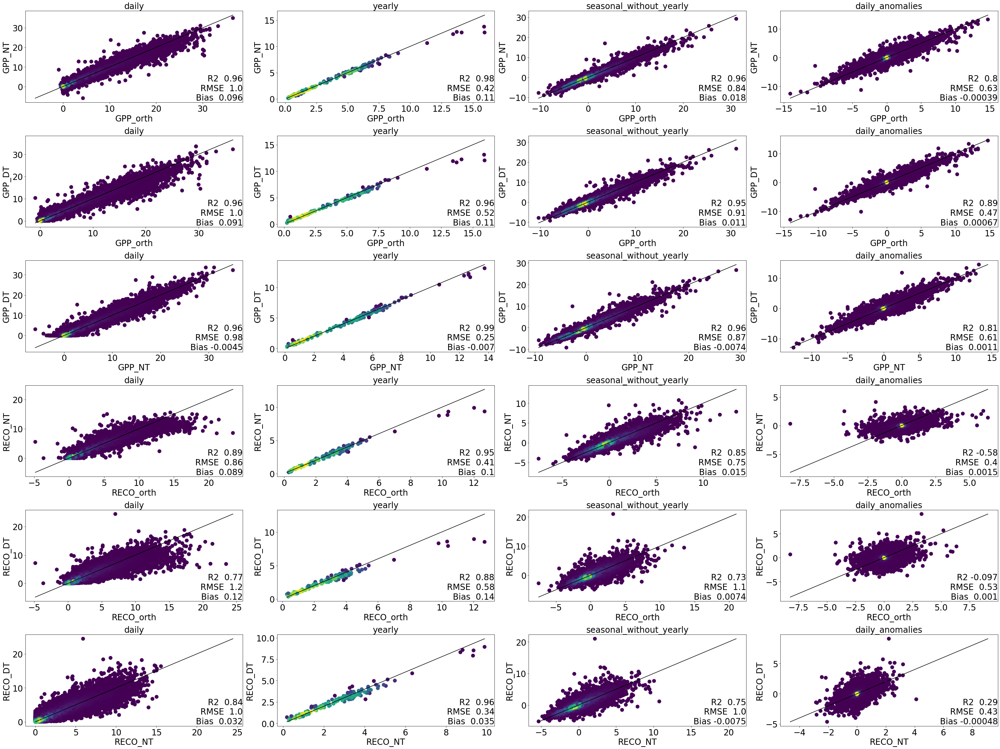

In [101]:
for method in ["ann", "orth"]:
    cross_consistency_plots(data, "/home/kaicohrs/Repositories/dml-4-fluxes", index="3", method=method)

In [ ]:

daily_avg = data.groupby(['site', 'Year', 'doy'])[flux + "_" + method_1].mean()
daily_avg = daily_avg.rename(flux + "_" + method_1+"_daily_avg")
data = data.join(daily_avg, on=['site', 'Year', 'doy'])

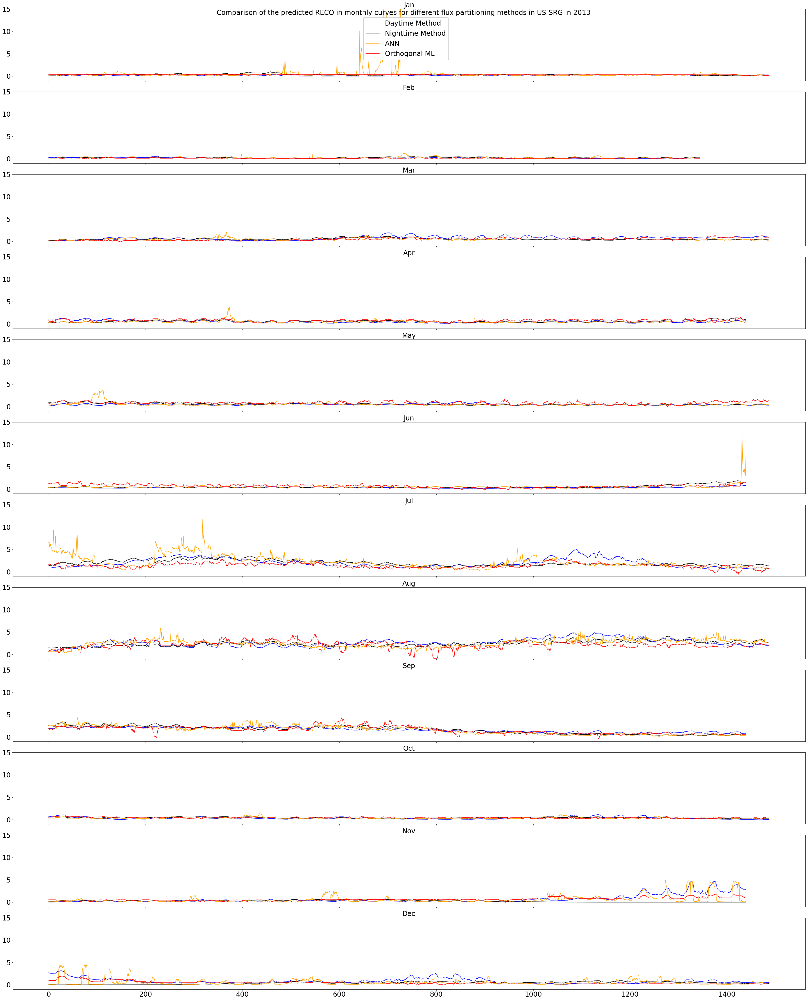

In [23]:
monthly_curves(DML, site="US-SRG", year=2013, flux="RECO", res=False)


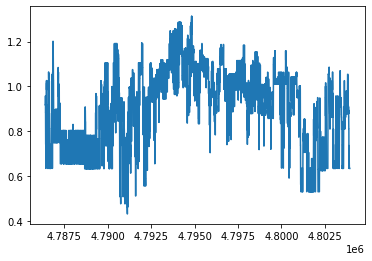

In [62]:
site = "FI-Hyy"
year = 2007
lue_orth = DML[(DML["site"] == site) & (DML["Year"] == year)]["LUE_orth"]
plt.plot(lue_orth)

In [100]:
southern_hemisphere = ["AU-Cpr",
                            "AU-DaP",
                            "AU-Dry",
                            "AU-How",
                            "AU-Stp",
                            "ZA-Kru",
                            "GF-Guy"] #Northern hemisphere but still filtered out due to lat < 5
DML = data.loc[~np.isin(data['site'],southern_hemisphere),:]

only_one_year = ["IT-Cpz",
                    "Be-Lon",
                    "IT-Ro1",
                    "US-ARM",
                    "US-MMS",
                    "US-UMB"]
data = data.loc[~np.isin(data['site'],only_one_year),:]

In [ ]:
only_one_year = ["CH-Cha",
                    "Be-Lon",
                    "DE-Gri",
                    "DE-Hai",
                    "DK-Sor",
                    "FI-Hyy",
                    "FR-FBn",
                    "ES-Abr",
                    ]

DML = DML.loc[np.isin(DML['site'],only_one_year),:]

In [39]:
DML = DML.drop(columns = ['VPD_n', 'SW_ratio',
       'wdefcum', 'NEE_orth', 'VPD',
       'SW_POT_sm_diff', 'SW_IN', 'Q10',
       'LUE_orth', 'code', 'TA_n',
       'QC', 'NIGHT',
       'quality_mask', 'wdefcum_n', 'SW_POT_sm', 'Rb', 'TA'])

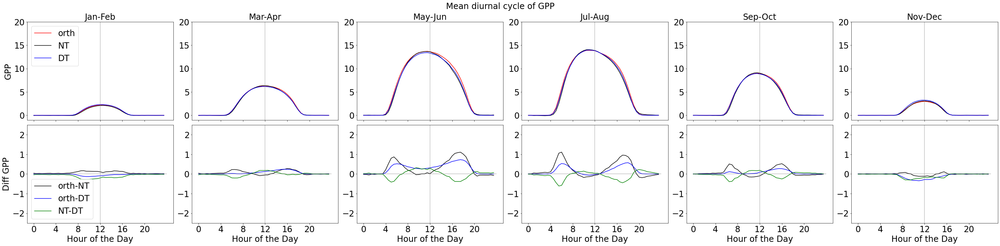

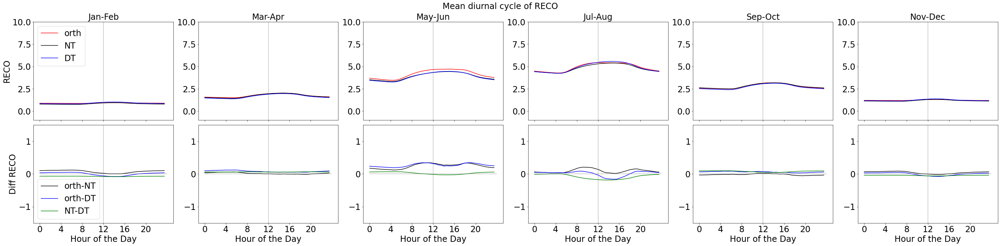

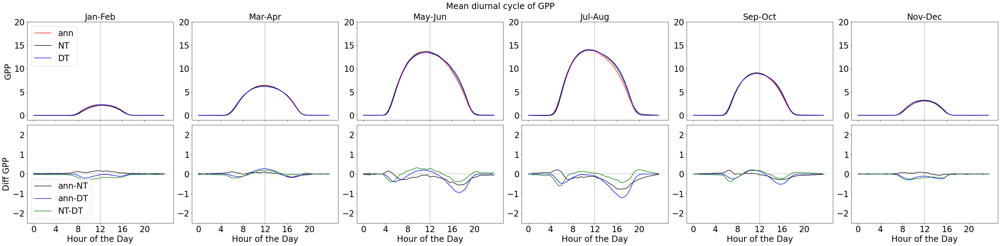

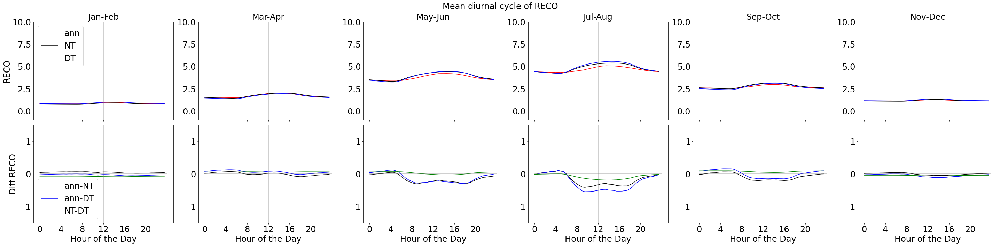

In [40]:
for method in ['orth', 'ann']:
    mean_diurnal_cycle(DML, 'GPP', '/home/kaicohrs/Repositories/results/DML_sota/images/' , method=method)
    mean_diurnal_cycle(DML, 'RECO', '/home/kaicohrs/Repositories/results/DML_sota/images/', method=method)

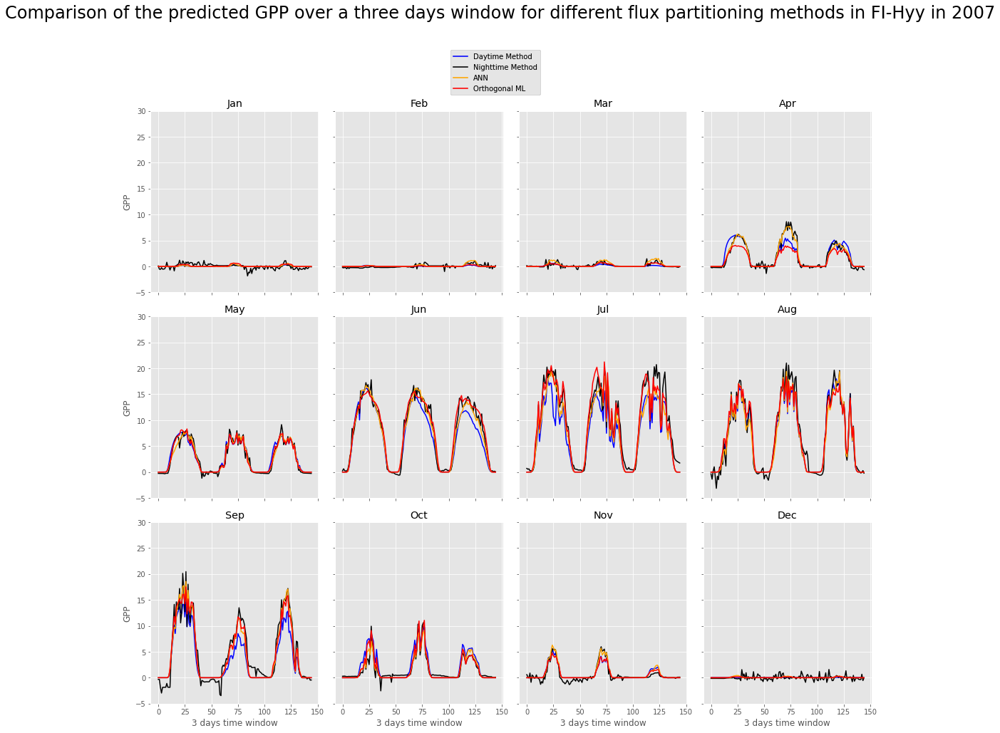

In [96]:
monthly_curves_cutout(DML, site="FI-Hyy", year=2007, flux="GPP", res=False)


In [55]:
import doubleml as dml
from doubleml import DoubleMLData`
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, StackingRegressor

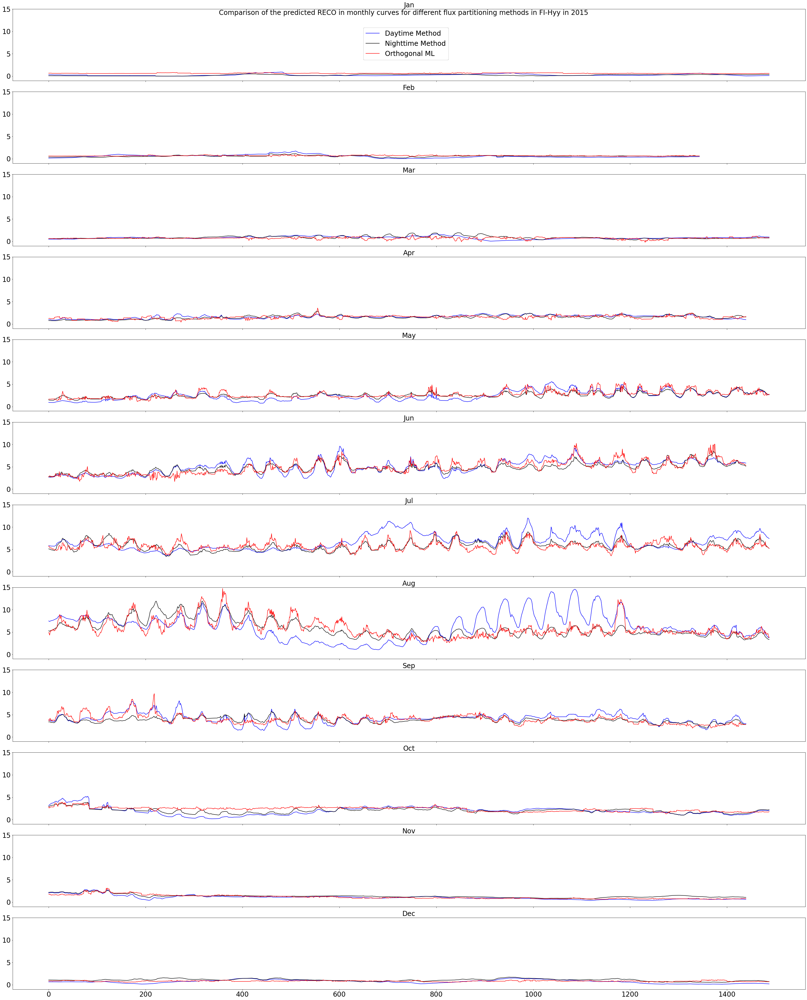

In [18]:
monthly_curves(exp.data, site="FI-Hyy", year=2015, flux="RECO", res=False)

# Almost all fitting steps by hand

In [33]:
dataset_config = dict(
    site_name="FI-Hyy",
    syn=False,
    Q10=1.5,  # only relevant if syn
    relnoise=0.1,  # only relevant if syn
    transform_T=True,  # if False, T = SW_IN
    month_wise=True,
    delta="heuristic3",
    X=[
        "VPD",
        "TA",
        "wdefcum",
        "SW_POT_sm",
        "SW_POT_sm_diff",
        "PA",
        "WS",
        "GPP_prox",
        "P",
        "WD_sin",
        "WD_cos",
        "NEE_nt_avg",
        "TS_1",
        "TS_2",
        "SWC_1",
        "SWC_2",
    ],  # ['VPD', 'TA'],#
    W=[],
    years=[2015],  #'all'
    norm_type="standardize",
)

model_y_config = dict(
    model="GradientBoostingRegressor",
    min_samples_split=5,
    min_samples_leaf=40,
    max_depth=1,
    n_estimators=300,
    # learning_rate=0.1,
    # max_depth=3
)
model_t_config = dict(
    model="GradientBoostingRegressor",
    min_samples_split=5,
    min_samples_leaf=40,
    max_depth=1,
    n_estimators=300,
    # max_depth=3
)
model_final_config = dict(
    model="GradientBoostingRegressor",
    min_samples_split=5,
    min_samples_leaf=40,
    max_depth=1,
    n_estimators=300,
    # max_depth=3
)
dml_config = dict(cv=10)

model_configs = dict(
    y=model_y_config, t=model_t_config, final=model_final_config, dml=dml_config
)

experiment_config = dict(
    experiment_type="flux_partitioning",
    comment=f"All sites, with extrapolation",
    extrapolate=False,
    seed=1000,
)  # note that currently I am not actually setting any seed

In [34]:
# All Data Preparation

data = load_data(dataset_config["site_name"])
data = unwrap_time(data)
data = standardize_column_names(data)
data = sw_pot_sm(data)
data = sw_pot_sm_diff(data)
data = w_def_cum(data)
data = diffuse_to_direct_rad(data)
data = GPP_prox(data)
data = WD_trans(data)


W_var = list(set(dataset_config["W"]) & set(data.columns))
if len(list(set(dataset_config["W"]) - (set(W_var)))):
    print(
        f'For site {dataset_config["site_name"]} variables {list(set(dataset_config["W"]) - set(W_var))} in W not available'
    )

X_var = list(set(dataset_config["X"]) & set(data.columns))
if len(list(set(dataset_config["X"]) - (set(X_var)))):
    print(
        f'For site {dataset_config["site_name"]} variables {list(set(dataset_config["X"]) - set(X_var))} in X not available'
    )

# drop problematic rows
data.replace(-9999, np.nan)
data = data[~pd.isna(data[X_var + W_var + ["SW_IN"]]).any(axis=1)]

if dataset_config["syn"]:
    data = synthetic_dataset(data, dataset_config["Q10"], dataset_config["relnoise"])
data = normalize(data, X_var + W_var, dataset_config["norm_type"])
if experiment_config["extrapolate"]:
    data_test = data.copy()
    data_test = normalize_test(data_test, X_var + W_var, dataset_config["norm_type"])

In [32]:
from dml4fluxes.experiments.utility import *

indices = data["Year"] == 2015

if dataset_config["transform_T"]:
    data.loc[indices, "T"], parameter = transform_T(
        x=data.loc[indices, "SW_IN"],
        delta=dataset_config["delta"],
        data=data.loc[indices, :],
        month_wise=dataset_config["month_wise"],
    )
T = data.loc[indices, "T"]
X = data.loc[indices, [var + "_n" for var in X_var]]

if not len(W_var):
    W = None
else:
    W = data.loc[indices, [var + "_n" for var in W_var]]

if dataset_config["syn"]:
    Y = data.loc[indices, "NEE_syn"]
else:
    Y = data.loc[indices, "NEE"]

# prints the parameters of the hyperbolic light curve

[ 0.09559358  0.39406547 -0.37405903]
[ 0.03312192  0.01838302 -0.59312195]
[ 0.06444883  0.02537968 -0.85326278]
[ 0.04439503  0.00426038 -1.38737916]
[ 0.0640886   0.00393608 -2.42268608]
[ 7.81582637e-02  2.90254954e-03 -4.42298195e+00]
[ 8.96082541e-02  3.08710143e-03 -5.15882694e+00]
[ 1.00656748e-01  4.22154235e-03 -5.12476561e+00]
[ 8.97108099e-02  3.74978015e-03 -3.75045792e+00]
[ 0.05755563  0.00350499 -2.25608004]
[ 0.0272163  -0.00200352 -1.18263846]
[ 0.03604157  0.00966256 -0.93442414]


In [28]:
# Other estimators you can potentially use
# Model_configs['y']['model] needs the name as a string and the rest of the keys must match the parameters of the model

from econml.dml import SparseLinearDML, LinearDML, NonParamDML

from sklearn.ensemble import GradientBoostingRegressor
from sklearn.base import clone
from sklearn.neural_network import MLPRegressor
from sklearn.svm import SVR, LinearSVR
from sklearn.linear_model import SGDRegressor

In [29]:
model_y = getattr(sys.modules[__name__], model_configs["y"]["model"])
config = model_configs["y"].copy()
del config["model"]
model_y = model_y(**config)

model_t = getattr(sys.modules[__name__], model_configs["t"]["model"])
config = model_t_config.copy()
del config["model"]
model_t = model_t(**config)

model_final = getattr(sys.modules[__name__], model_configs["final"]["model"])
config = model_final_config.copy()
del config["model"]
model_final = model_final(**config)

est = NonParamDML(
    model_y=model_y, model_t=model_t, model_final=model_final, **model_configs["dml"]
)

In [30]:
est.fit(Y=Y, X=X, W=W, T=T, cache_values=True)

In [31]:
def gpp(x, t):
    return -est.const_marginal_effect(x) * t


def reco(x, t, w=None, y=None):
    return np.mean(
        [
            est._models_nuisance[0][i]._model_y.predict(x, w)
            - est.const_marginal_effect(x)
            * (est._models_nuisance[0][i]._model_t.predict(x, w))
            for i in range(len(est._models_nuisance[0]))
        ],
        axis=0,
    )
    # return np.mean([est._models_nuisance[0][i]._model_y.predict(x, w)-est.const_marginal_effect(x)*t for i in range(len(est._models_nuisance[0]))], axis=0)
    # return np.mean([y-est.const_marginal_effect(x)*(est._models_nuisance[0][i]._model_t.predict(x, w)) for i in range(len(est._models_nuisance[0]))], axis=0)


def reco_res(nee, x, t):
    return nee + gpp(x, t)


def nee(x, t, w=None):
    return -gpp(x, t) + reco(x, t, w)


def t(x, w=None):
    return np.mean(
        [
            est._models_nuisance[0][i]._model_t.predict(x, w)
            for i in range(len(est._models_nuisance[0]))
        ],
        axis=0,
    )


def lue(x):
    return -est.const_marginal_effect(x)

# Fitting on all sites

In [ ]:
dataset_config["site_name"] = ("all",)
dataset_config["years"] = ("all",)

exp = experiment.FluxPartDML()
exp.new("all")
exp.configs(experiment_config, dataset_config, model_configs)
exp.all_analysis()